In [1]:
!sudo apt update
!sudo apt install graphviz

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:6 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:9 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [4,532 kB]
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [9,053 kB]
Get:13 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packa

In [2]:
!pip install torchviz

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 126.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [3]:
!pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 25.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.7/242.7 kB 20.7 MB/s eta 0:00:00


In [4]:
!pip install optuna-dashboard

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 98.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.8/103.8 kB 9.6 MB/s eta 0:00:00


In [210]:
!pip install onnx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.6/17.6 MB 77.8 MB/s eta 0:00:00


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Preparación y Análisis de Datos**



In [208]:
import cv2
import folium
import matplotlib.pyplot as plt
import numpy as np
import optuna
import plotly
import pandas as pd
import seaborn as sns
import torch
import torch.optim as optim
import torch.nn as nn
import random
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import torchvision.models as models
import torchvision
import os
import torch.nn.functional as F
import time
import glob

from folium import plugins
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision import datasets, transforms
from sklearn.preprocessing import MultiLabelBinarizer,StandardScaler
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from PIL import Image
from torchviz import make_dot
from datetime import date
from torchvision import models
from datetime import datetime
from optuna_dashboard import run_server
from sklearn.utils.class_weight import compute_class_weight


#Verificamos nuestas versiones
print(f"Pytorch version: {torch.__version__}")
print(f"Torchvision version: {torchvision.__version__}")
print(f"NumPy version: {np.__version__}")
print(f"Pandas version: {pd.__version__}")
print(f"Optuna version: {torchvision.__version__}")

Pytorch version: 2.6.0+cu124
Torchvision version: 0.21.0+cu124
NumPy version: 2.0.2
Pandas version: 2.2.2
Optuna version: 0.21.0+cu124


In [7]:
# Verficamos en que dispositivo estamos.
device = (
    "cuda"
    if torch.cuda.is_available()
    else "cpu"
)
print(f"Using device: {device}")

# Mostrar información adicional del dispositivo (sólo si es una GPU)
if device == "cuda":
    print(f"CUDA Device Name: {torch.cuda.get_device_name(0)}")
    print(f"CUDA Device Count: {torch.cuda.device_count()}")
    print(f"CUDA Device Properties: {torch.cuda.get_device_properties(0)}")
else:
    print("Using CPU")
    print(f"Number of CPU threads available: {torch.get_num_threads()}")

Using device: cuda
CUDA Device Name: Tesla T4
CUDA Device Count: 1
CUDA Device Properties: _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15095MB, multi_processor_count=40, uuid=c846ab2f-5f20-b8b0-aced-c5931d96ed4f, L2_cache_size=4MB)


# **Dataset**

***Datos en el csv***



*   **Metadatos** : Información contextual sobre cada POI, incluyendo:

    1.   **id** : Identificador único para cada punto de interés.
    2.   **name** : Nombre descriptivo del POI.
    3. **shortDescription** : Breve descripción textual del punto de interés.
    4. **Categorización** : Columna categories que indica el tipo de atracción
    o temática.
    5. **tier** : Clasificación por nivel de relevancia o popularidad.
    6. **Ubicación geográfica** : Coordenadas (locationLon, locationLat), barrio, distrito.
    7. **tags** : Etiquetas descriptivas asociadas al POI.
    8. **xps** : Experiencia obtenida por el usuario al visitar el POI (para gamificación).
    9. **main_image_path** : Ruta a la imagen principal de cada POI.

*   **Métricas de engagement**: Indicadores cuantitativos de la interacción de los usuarios con cada POI:

    1. **Visits** : Número de visitas registradas.
    2. **Likes** y **Dislikes** : Cantidad de valoraciones positivas y negativas recibidas.
    3. **Bookmarks**: Número de veces que el POI ha sido añadido a favoritos.


In [8]:
data_csv = '/content/drive/MyDrive/Colab Notebooks/datos/poi_dataset.csv'
df = pd.read_csv(data_csv)

# Mostramos las primeras 10 filas
df.head(10).T

,0,1,2,3,4,5,6,7,8,9
id,4b36a3ed-3b28-4bc7-b975-1d48b586db03,e32b3603-a94f-49df-8b31-92445a86377c,0123a69b-13ac-4b65-a5d5-71a95560cff5,390d7d9e-e972-451c-b5e4-f494af15e788,023fc1bf-a1cd-4b9f-af78-48792ab1a294,bcd58127-76bd-44e7-84d8-cc25b46c7962,f45b1b38-36cd-4479-bac1-544ca6b1e685,ca8d89fa-3e9e-4639-ac01-7f83c5d0130e,0089bb20-c132-496c-b215-1986fcfa9d4b,297257de-a00a-4e99-bd21-b3a2c529e916
name,Galería Fran Reus,Convento de San Plácido,Instituto Geológico y Minero de España,Margarita Gil Roësset,Museo del Traje. Centro de Investigación del P...,Clara Campoamor,Plaza de la Encarnación,Atentado en 1985,Cuesta de los ciegos,Fragmento de la muralla árabe de Madrid
shortDescription,La Galería Fran Reus es un espacio dedicado a ...,"El Convento de San Plácido en Madrid, fundado ...","El Instituto Geológico y Minero de España, sit...","Margarita Gil Roësset, escultora y poetisa esp...","El Museo del Traje de Madrid, fundado en 2004,...","Clara Campoamor fue una abogada, escritora y p...",Debe su nombre al desaparecido convento de la ...,1985. ETA asesina en Madrid al coronel auditor...,La Cuesta de los Ciegos es una escalera empedr...,Este vestigio de la muralla árabe del siglo IX...
categories,"['Escultura', 'Pintura']","['Patrimonio', 'Historia']","['Ciencia', 'Patrimonio']",['Cultura'],"['Patrimonio', 'Cultura']","['Historia', 'Cultura']","['Historia', 'Arquitectura']",['Historia'],"['Arquitectura', 'Historia']","['Arquitectura', 'Patrimonio']"
tier,1,1,2,1,1,1,2,3,3,2
locationLon,2.642262,-3.704467,-3.699694,-3.691228,-3.727822,-3.690211,-5.992007,-3.677161,-3.714567,-3.714546
locationLat,39.572694,40.423037,40.442045,40.427256,40.439665,40.435082,37.392953,40.4358,40.412984,40.414866
tags,[],[],[],[],[],[],[],[],[],[]
xps,500,500,250,500,500,500,250,100,150,250
Visits,10009,10010,10015,10011,10020,10019,10013,10019,10007,10018


# Análisis exploratorio del dataset

In [9]:
# Filas y columnas
print(f"Dimensiones: {df.shape}")

Dimensiones: (1569, 14)


In [10]:
# Tipos de datos y valores nulos
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1569 entries, 0 to 1568
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                1569 non-null   object 
 1   name              1569 non-null   object 
 2   shortDescription  1569 non-null   object 
 3   categories        1569 non-null   object 
 4   tier              1569 non-null   int64  
 5   locationLon       1569 non-null   float64
 6   locationLat       1569 non-null   float64
 7   tags              1569 non-null   object 
 8   xps               1569 non-null   int64  
 9   Visits            1569 non-null   int64  
 10  Likes             1569 non-null   int64  
 11  Dislikes          1569 non-null   int64  
 12  Bookmarks         1569 non-null   int64  
 13  main_image_path   1569 non-null   object 
dtypes: float64(2), int64(6), object(6)
memory usage: 171.7+ KB


In [11]:
 # Valores únicos por columna
print(df.nunique())

id                  1492
name                1458
shortDescription    1491
categories           224
tier                   4
locationLon         1437
locationLat         1439
tags                1418
xps                   13
Visits                37
Likes               1241
Dislikes            1154
Bookmarks            819
main_image_path     1492
dtype: int64


Podemos observar que:

*   El tamaño de nuestro dataset es de 1569 filas con 14 columnas.
*   No tenemos valores nulos.
*   Existen variables con textos.
*   Contamos con variables categoricas.




**Verificación de ciertas variables** :
      
    1.   Variables categóricas
    2.   Listas vacias en nuestras variables categóricas
    3.   Valores únicos en columnas.



In [12]:
#Vamos a observar los valores de "tier"
df.tier.unique()

array([1, 2, 3, 4])

In [13]:
#Vamos a observar "categories"
df.categories.unique()

array(["['Escultura', 'Pintura']", "['Patrimonio', 'Historia']",
       "['Ciencia', 'Patrimonio']", "['Cultura']",
       "['Patrimonio', 'Cultura']", "['Historia', 'Cultura']",
       "['Historia', 'Arquitectura']", "['Historia']",
       "['Arquitectura', 'Historia']", "['Arquitectura', 'Patrimonio']",
       "['Cultura', 'Ciencia']", "['Cultura', 'Patrimonio']",
       "['Pintura', 'Escultura']", "['Escultura', 'Pintura', 'Historia']",
       "['Cultura', 'Historia']",
       "['Cultura', 'Patrimonio', 'Gastronomía']", '[]',
       "['Gastronomía']", "['Arquitectura', 'Historia', 'Patrimonio']",
       "['Escultura', 'Historia', 'Patrimonio']",
       "['Arquitectura', 'Escultura', 'Historia']", "['Pintura']",
       "['Arquitectura']", "['Naturaleza', 'Cultura']",
       "['Arquitectura', 'Cultura']", "['Escultura']",
       "['Historia', 'Arquitectura', 'Patrimonio']",
       "['Cultura', 'Patrimonio', 'Historia', 'Naturaleza']",
       "['Pintura', 'Escultura', 'Historia']",
   

In [14]:
#Vamos a observar "tags"
df.tags.unique()

array(['[]', "['s.XX']",
       "['Canaletto', 'paisaje', 'vedutismo', 's.XVIII', 'Cuadro', 'Venecia']",
       ..., "['Estatuas', 'Plaza']",
       "['Alcalá', 'Gran Vía', 'Metrópolis']",
       "['Arquitectura', 'Cisterciense', 'Císter', 'Moreruela', 'Zamora', 'Ruinas', 'Monasterio']"],
      dtype=object)

In [15]:
# Vamos a observar cuantos tenemos por cda categoria categoria individual
all_tags = [tag for tags_list in df['tags'].apply(eval) for tag in tags_list]
all_tags_count = pd.Series(all_tags).value_counts()
all_tags_count

,count
Historia,802
Madrid,700
Cultura,583
Arquitectura,398
Patrimonio,353
...,...
Carlos v,1
Carlos ii,1
Guerra de sucesión,1
Dinastía,1


In [16]:
#Listado de categorías
categories = set(category for categories_list in df['categories'].apply(eval) for category in categories_list)
categories

{'Arquitectura',
 'Ciencia',
 'Cine',
 'Cultura',
 'Escultura',
 'Gastronomía',
 'Historia',
 'Misterio',
 'Naturaleza',
 'Ocio',
 'Patrimonio',
 'Pintura'}

Las variables "categories" y "tags" parecian listas pero realmente son realmente son string, debemos pasarlos a listas para su manejo.

In [17]:
#Las pasamos a listas
df['categories'] = df['categories'].apply(eval)
df['tags'] = df['tags'].apply(eval)

In [18]:
# Confirmamos
df['categories'][0]


['Escultura', 'Pintura']

In [19]:
df['tags'][220]

['Arquitectura',
 'Historia',
 'Madrid',
 'Transformación',
 'Educación',
 'Religión',
 'Patrimonio',
 'Estilo Isabelino',
 'Estilo Neogótico',
 'Turismo']

In [20]:
# Verificamos que no existe nulos
print(df.isnull().sum())

id                  0
name                0
shortDescription    0
categories          0
tier                0
locationLon         0
locationLat         0
tags                0
xps                 0
Visits              0
Likes               0
Dislikes            0
Bookmarks           0
main_image_path     0
dtype: int64


In [21]:
# Verificamos si tenemos listas vacias en "tags"
df.tags.apply(len).value_counts()

,count
tags,
10,473
13,466
1,136
0,107
4,102
12,88
5,58
3,56
6,33


In [22]:
df.categories.apply(len).value_counts()

,count
categories,
3,1073
4,325
2,106
1,63
0,2


In [23]:
# Resumen numérico y categórico de todo
print(df.describe(include='all'))

                                          id  \
count                                   1569   
unique                                  1492   
top     a0f3f39c-fc87-4031-900d-d4776b1f3491   
freq                                       7   
mean                                     NaN   
std                                      NaN   
min                                      NaN   
25%                                      NaN   
50%                                      NaN   
75%                                      NaN   
max                                      NaN   

                                           name  \
count                                      1569   
unique                                     1458   
top     Ambresbury Banks en el bosque de Epping   
freq                                          7   
mean                                        NaN   
std                                         NaN   
min                                         NaN   
25%            

In [24]:
print(df['tier'].value_counts())

tier
1    837
2    622
3    103
4      7
Name: count, dtype: int64


# Preprocesamiento de datos


**Codificación de variables categóricas, manejo de nulos y eliminación de variables**

En ambas variables categoricas contamos con listas vacias.

*   Para la variable "tags":
  
  Muestra 107 registros vacios, podríamos agregar una nueva columna que sea el total de tags que se tiene por registro. De esta forma tendremos 0 en los vacios y así podemos trabajar con ellos. No considero que sera efectivo realizar una imputación ni eliminarnos dado que son bastantes registros y podría darnos información el no tener etiquetas. Y tenemos muchisimos tags para realizarles un one-hot encoding.

*   Para la variable "categories":

  Tenemos muchísimas convinaciones, por lo que necesitamos realizar One Hot Encoding para asignar valores numéricos a nues a las diferentes categorías de nuestras variables categóricas. Colocando un 1 en la categoría que tenga el registro.

Al finalizar podemos eliminar las colummnas "tags" y "categories" dado que no trabajaremos con ellas porque son textos y ya contamos con nuevas variables que las representan.

Como pudimos observar la variable 'tier' también es una variable categorica así que aplicaremos un one-hot encoding dado que son pocos varoles únicos



In [27]:
# Sumamos los elementos en la lista de tags para asignarlos a nueva variable.
def contar_elementos(lista):
    return len(lista)

df['total_tags'] = df['tags'].apply(contar_elementos)


In [28]:
# Vamos a crear una columna por cada categoria y asignaremos 1 si esta en 'categories' de ese registro o 0 de lo contrario.
mlb = MultiLabelBinarizer()

one_hot_encoded_categories = mlb.fit_transform(df['categories'])

In [29]:
# Creo un DataFrame para cada resultado One-Hot Encoding
one_hot_categories_df = pd.DataFrame(one_hot_encoded_categories, columns=mlb.classes_, index=df.index)

# Concatenarlo con el DataFrame original
df = pd.concat([df, one_hot_categories_df], axis=1)

In [30]:
# Como la vairable 'shortDescription' es texto vamos a tomar su tamaño para valorar si trabajamos con ella.
df['len_shortDescription'] = df['shortDescription'].str.len()

In [31]:
# Vamos a observar el tipo de la variable 'tier' así como sus valores.
print(df['tier'].dtype)

int64


In [32]:
# Vamos a mapear los valores existentes de 'tier' a enteros consecutivos empezando desde 0 y los reemplazamos por los existentes
tier_mapping = {tier: i for i, tier in enumerate(sorted(df['tier'].unique()))}
df['tier'] = df['tier'].map(tier_mapping)

# Aplicamos one-hot encoding, debemos pasar a tensor y luego lo volvemos a transormar en un array de numpy
one_hot_encoded_tier = torch.nn.functional.one_hot(torch.tensor(df['tier'].values), num_classes=len(df['tier'].unique())).numpy()

# Tenemos que crear los nombres de las nuevas columnas para el one-hot encoding de "tier" ('tier_0', 'tier_1', ...)
tier_columns = [f'tier_{i}' for i in sorted(df['tier'].unique())]

one_hot_tier_df = pd.DataFrame(one_hot_encoded_tier, columns=tier_columns, index=df.index)

# Concatenamos con el dataframe original
df = pd.concat([df, one_hot_tier_df], axis=1)

In [33]:
#Verifiquemos los cambios para eliminar las columans de "tags" y "categories"

df.head(5).T

,0,1,2,3,4
id,4b36a3ed-3b28-4bc7-b975-1d48b586db03,e32b3603-a94f-49df-8b31-92445a86377c,0123a69b-13ac-4b65-a5d5-71a95560cff5,390d7d9e-e972-451c-b5e4-f494af15e788,023fc1bf-a1cd-4b9f-af78-48792ab1a294
name,Galería Fran Reus,Convento de San Plácido,Instituto Geológico y Minero de España,Margarita Gil Roësset,Museo del Traje. Centro de Investigación del P...
shortDescription,La Galería Fran Reus es un espacio dedicado a ...,"El Convento de San Plácido en Madrid, fundado ...","El Instituto Geológico y Minero de España, sit...","Margarita Gil Roësset, escultora y poetisa esp...","El Museo del Traje de Madrid, fundado en 2004,..."
categories,"[Escultura, Pintura]","[Patrimonio, Historia]","[Ciencia, Patrimonio]",[Cultura],"[Patrimonio, Cultura]"
tier,0,0,1,0,0
locationLon,2.642262,-3.704467,-3.699694,-3.691228,-3.727822
locationLat,39.572694,40.423037,40.442045,40.427256,40.439665
tags,[],[],[],[],[]
xps,500,500,250,500,500
Visits,10009,10010,10015,10011,10020


In [34]:
# Eliminamos las columnas que no son necesarias
columnas_a_eliminar = ['categories', 'tags', 'shortDescription', 'tier']
df = df.drop(columns=columnas_a_eliminar)


**Vamos a visualizar nuestros datos**

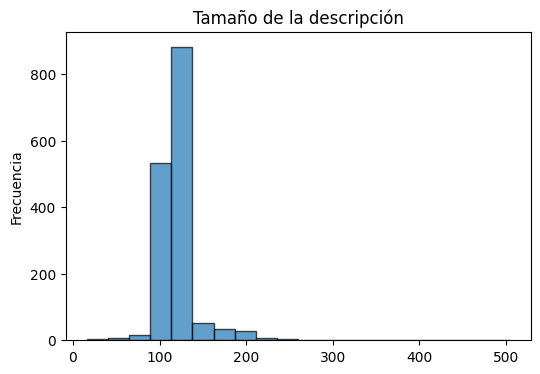

Media: 120.38
Desviación estándar: 24.57


In [35]:

plt.figure(figsize=(6, 4)) # Define el tamaño
plt.hist(df['len_shortDescription'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Tamaño de la descripción')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['len_shortDescription'].mean():.2f}")
print(f"Desviación estándar: {df['len_shortDescription'].std():.2f}")

Podemos observar que cuenta con una distribución bastante sesgada a la derecha, lo que nos indica que muchas descripciones son cortas y también van decreciendo como la longitud de las mismas aumenta.

Tenemos un pico muy importante entre 125 y la mayoria se concentran entre 80 y 150.

Su distribución parece que nos indica que hay una longitud estándar para las descripción. Por esta razón considero que no es una variable que nos podría aportar información igual que el "id" y el "name".

De media los textos tienen un tamaño de 120 palabras y en el gráfico observamos que son la mayoría.

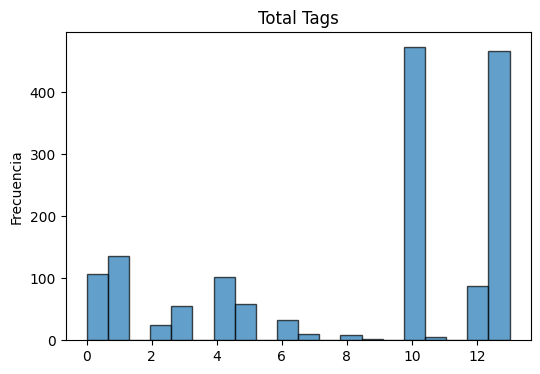

Media: 8.48
Desviación estándar: 4.57


In [36]:
plt.figure(figsize=(6, 4))
plt.hist(df['total_tags'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Total Tags')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['total_tags'].mean():.2f}")
print(f"Desviación estándar: {df['total_tags'].std():.2f}")

Parece que esta nueva variable nos puede aportar informacimación dado que muestra una distribución que no es uniforme.
Tiene picos significativos en los tags 0, 1,4, 10 y 13 y picos casi nulos en 8, 9 y 11.

De media tienen 8.48 tags pero en la desviación estandar a 4.57 nos damos cuentas que algunos tiene muchos más o muchos menos que la media. Podemos observar que tenemos poco registros en la media


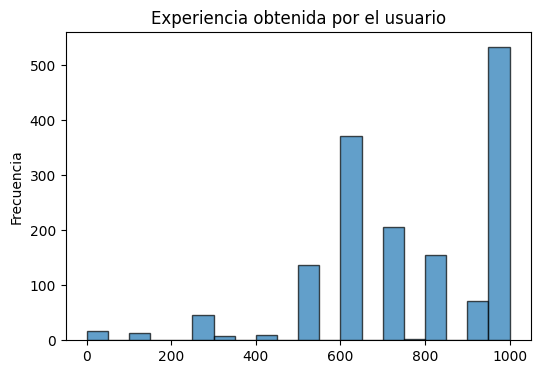

Media: 750.38
Desviación estándar: 228.32


In [37]:
plt.figure(figsize=(6, 4))
plt.hist(df['xps'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Experiencia obtenida por el usuario')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['xps'].mean():.2f}")
print(f"Desviación estándar: {df['xps'].std():.2f}")

Parece que la mayoria de los puntos tiene una experiencia positiva, podemos observar que la frecuencia disminuye para los valores más pequeños o negativos.

La distribución no es simétrica, vemos que esta sesgada sobre todo hacia valores más alto, como podemos ver en el de 1,000.

Considero que es una variable muy importante que podría mostrar una correlación importante.

Nuestra media es alta 750.38 lo que nos dice que una gran parte de los usuarios tiene niveles de experiencia más elevados. Y como la desviación también es alta observamos como los datos están bastanten dispersos.

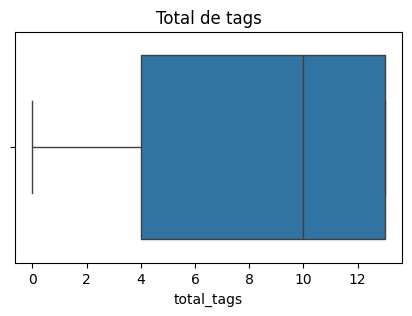

In [38]:
plt.figure(figsize=(5, 3))
sns.boxplot(x=df['total_tags'])
plt.title('Total de tags')
plt.show()


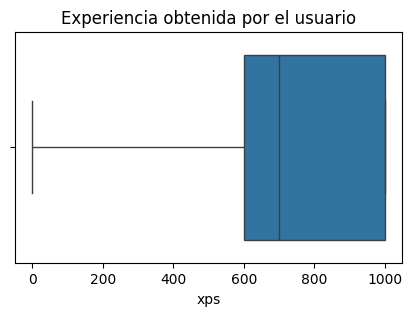

In [39]:
plt.figure(figsize=(5, 3))
sns.boxplot(x=df['xps'])
plt.title('Experiencia obtenida por el usuario')
plt.show()

En ambos Boxplots podemos observar que no se observan outliers.

*   En "xps" observamos una concentración masiva de usuarios con alta experiencia. Confirmando lo que vimos en el histograma.

*   En "total_tags" podemos ver que la mediana esta alrededor de 10. Los valores del box van desde 4-13, siendo 13 el maximo (como en el histograma).  

Ambas variables deben considerarse para el entrenamiento porque sus distribuciones parece que nos puden ayudar a diferenciar los ejemplos.


In [40]:
# Eliminamos las columnas que no son necesarias
columnas_a_eliminar = ['id', 'name', 'len_shortDescription']
df = df.drop(columns=columnas_a_eliminar)


# **Creación de métrica de engagement**

Será nuestra variable objetivo.

Basada en las variables:

*  Visits
*  Likes
*  Dislikes
*  Bookmarks


Visualicemos estas variables.

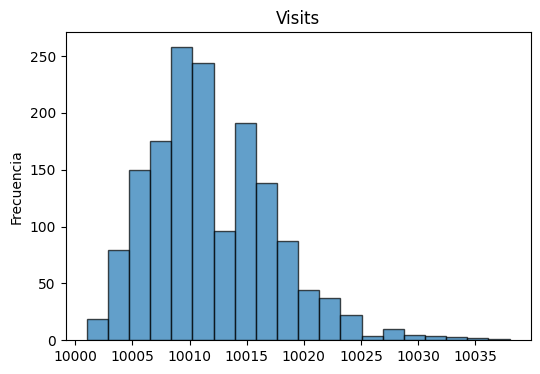

Media: 10011.94
Desviación estándar: 5.46


In [41]:
plt.figure(figsize=(6, 4))
plt.hist(df['Visits'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Visits')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['Visits'].mean():.2f}")
print(f"Desviación estándar: {df['Visits'].std():.2f}")

Podemos observar que la mayoría de las visitas estan en un rango muy pequeño, aproximadamente entre 10,003 y 10019.

Parece que casi todos los puntos de interés tienen un número de visitas alto.

Podemos observar que la media cae entre los picos mas altos y con la desviación tan pequeña lo comprobamos dado que la mayoria de datos se central alrededor de la media.

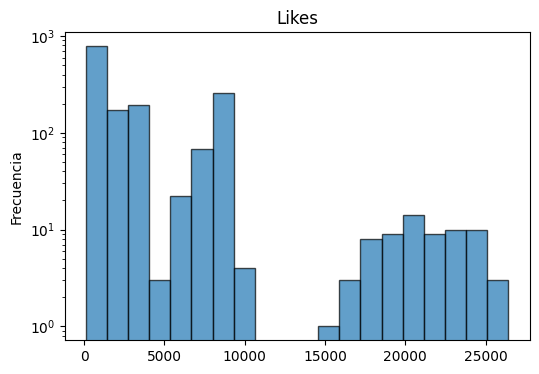

Media: 3623.91
Desviación estándar: 4817.88


In [42]:
plt.figure(figsize=(6, 4))
plt.hist(df['Likes'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Likes')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['Likes'].mean():.2f}")
print(f"Desviación estándar: {df['Likes'].std():.2f}")

Observamos que la distribución tiene muchos picos, donde parece que existen varios grupos. También vemos sesgo. Para este caso la media no es buena para representarnos el centro de los datos.

Vemos que una gran cantidad de sitios tiene pocos likes (casi 1,000) y casí no se observan frecuencia entre 10,000 y 15,000.

Una desviación estándar tan alta indica muchisima varidad. Los datos están muy dispersos y no se agrupan estrechamente alrededor de la media.

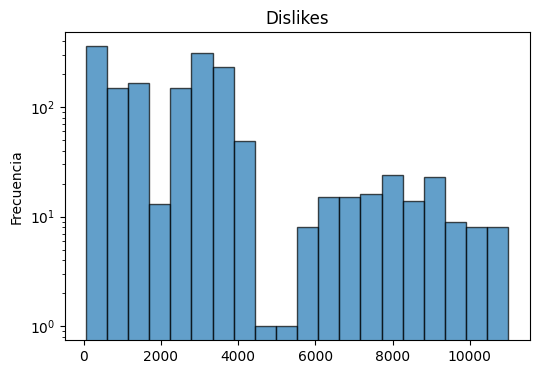

Media: 2526.31
Desviación estándar: 2225.54


In [43]:
plt.figure(figsize=(6, 4))
plt.hist(df['Dislikes'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Dislikes')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['Dislikes'].mean():.2f}")
print(f"Desviación estándar: {df['Dislikes'].std():.2f}")

Tambien es una distribución dispersa. Vemos una gran caida alrededor de los 5,000, donde casi no hay registros.

Observamos picos más alto en 0 y aproximadamente 3,000, así como menor frecuencia entre 4,500 y 5,500.

Una desviación estándar tan alta indica muchisima varidad. Los datos están muy dispersos y no se agrupan estrechamente alrededor de la media.


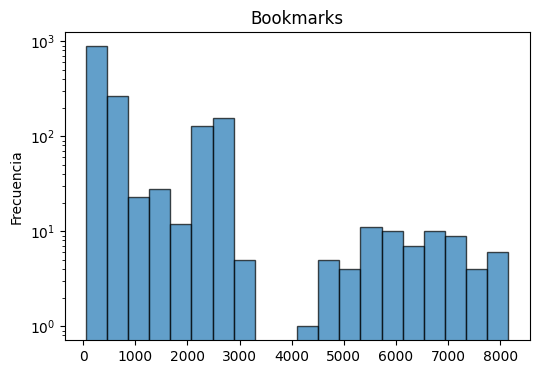

Media: 973.26
Desviación estándar: 1453.33


In [44]:
plt.figure(figsize=(6, 4))
plt.hist(df['Bookmarks'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Bookmarks')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['Bookmarks'].mean():.2f}")
print(f"Desviación estándar: {df['Bookmarks'].std():.2f}")

Podemos observar un punto muy alto cerca de cero, lo cual nos dice que existen muchos sitios con pocos Bookmarks. Existe un vacio entre los 3,200 y 4,100 aproximadamente que tambien lo podemos observar en las gráficas anteriores.

Contamos con una distribución irregular y dispersa. En este gráfico tambien contamos con sesgo importante.

La media es un valor bajo, lo que podemos observa que esta afectada por la gran cantidad e valores cerca del cero. Y nuestra desviación es muy alta en compración con la media lo que nos confirma que hay puntos de interes con muy pocos y otros con muchos Bookmarks.

Vamos a probar condiferentes métricas de engagement.

  **Primera métrica** valorando interacciones:

        engagement = (Número de Interacciones / Alcance) * 100

  Con nuestra variables quedaría:

        engagement = ((Likes + Dislikes + Bookmarks) / Visits) * 100;

  *Nota*: los Dislikes aunque no son positivos, nos indican una interacción.



In [45]:
engagement = ((df['Likes'] + df['Dislikes'] + df['Bookmarks']) / df['Visits']) * 100
df['engagement'] = engagement

print("\nPrimeras 5 filas con la nueva métrica 1:")
print(df[['Visits', 'Likes', 'Dislikes', 'Bookmarks','engagement']].head())


Primeras 5 filas con la nueva métrica 1:
   Visits  Likes  Dislikes  Bookmarks  engagement
0   10009    422      3582         78   40.783295
1   10010   7743        96       2786  106.143856
2   10015   3154       874        595   46.160759
3   10011   8559        79       2358  109.839177
4   10020    915      2896        143   39.461078


In [46]:
df['engagement'].max()

326.6806512835881

In [47]:
df['engagement'].min()

30.99561053471668

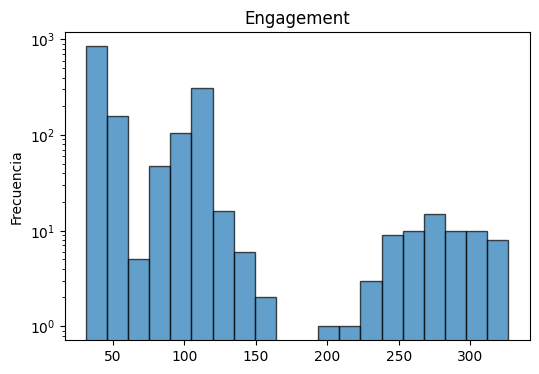

Media: 71.15
Desviación estándar: 53.71


In [48]:
plt.figure(figsize=(6, 4))
plt.hist(df['engagement'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Engagement')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['engagement'].mean():.2f}")
print(f"Desviación estándar: {df['engagement'].std():.2f}")

Dado que no tenemos valores negativos podemos observar que al sumar los Dislikes como interacciones no es muy beneficioso. Por ejemplo un punto de interes con muchas visitas (recordemos que los valores son altos) y muchos Dislikes podria tener un engagement alto.

**Segunda métrica**:

  Se busca reflejar qué tan efectivas son las visitas para generar interacciones (Likes, Bookmarks) y cómo se comportan las interacciones negativas (Dislikes) en relación con las positivas.
          
      engagement = (Likes / Visits+ϵ) + (Bookmarks / Visits+ϵ) - (Dislikes / Likes+Bookmarks+ϵ)


  *Nota*: para evitar divisiones entre cero utilizamos ϵ con un valor muy pequeño.

          

In [49]:
# Pequeño valor para evitar divisiones por cero
epsilon = 1e-8

# Calculamos los ratios individuales para Likes, Bookmarks y Dislikes
df['likes_visits'] = df['Likes'] / (df['Visits'] + epsilon)
df['bookmarks_visits'] = df['Bookmarks'] / (df['Visits'] + epsilon)
df['dislikes_positives'] = df['Dislikes'] / (df['Likes'] + df['Bookmarks'] + epsilon)

# Calculamos el nuevo engagement
df['engagement_ratios'] = df['likes_visits'] + df['bookmarks_visits'] - df['dislikes_positives']

print("\nPrimeras 5 filas con las nuevas métricas de ratios y 'engagement_ratios':")
print(df[['Visits', 'Likes', 'Dislikes', 'Bookmarks', 'likes_visits', 'bookmarks_visits', 'dislikes_positives','engagement_ratios']].head())


Primeras 5 filas con las nuevas métricas de ratios y 'engagement_ratios':
   Visits  Likes  Dislikes  Bookmarks  likes_visits  bookmarks_visits  \
0   10009    422      3582         78      0.042162          0.007793   
1   10010   7743        96       2786      0.773526          0.278322   
2   10015   3154       874        595      0.314928          0.059411   
3   10011   8559        79       2358      0.854960          0.235541   
4   10020    915      2896        143      0.091317          0.014271   

   dislikes_positives  engagement_ratios  
0            7.164000          -7.114045  
1            0.009118           1.042730  
2            0.233129           0.141210  
3            0.007236           1.083264  
4            2.737240          -2.631651  


In [50]:
df['engagement_ratios'].max()

3.225353466665573

In [51]:
df['engagement_ratios'].min()

-25.016479309993493

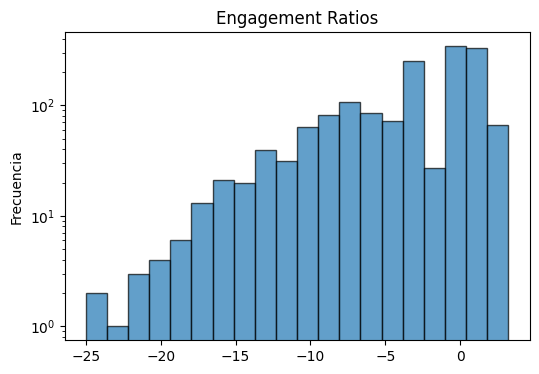

Media: -3.41
Desviación estándar: 5.01


In [ ]:
plt.figure(figsize=(6, 4))
plt.hist(df['engagement_ratios'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Engagement Ratios')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['engagement_ratios'].mean():.2f}")
print(f"Desviación estándar: {df['engagement_ratios'].std():.2f}")

Al calcular los ratios le estamos dando más pesos a la calidad de la interacción en vez de al volumen, por esto vemos muchos valores negativos. Por lo que tendriamos información de mayor calidad.

También podemos observar que se muestra una distribución más gradual (no muestra espacio vacios), esto nos ayudara al momento definir el umbral para engagement alto o bajo.

**Tercera métrica**:

  Otrogaremos diferentes pesos a nuestra variables (segun la importancia que les demos) y se aplicara a una formula sencilla donde sumemos las intereacciones positivas y restamos la negativa.
          
      engagement = (Visits x Wv) + (Likes x Wl) + (Bookmarks x Wb) - (Dislikes x Wd)

In [52]:
# Definimos los pesos según la importancia que damos
# W_v = debe tener un peso bajo porque como hemos visto en las gráficas anteriores tienen numeros altos.
# W_l = normal
# W_b = debe ser alto dado que si el usuario decidio guardarlo es que desea verlo en un futuro, por eso tiene más valor que los Likes.
# W_d = debe ser más alto porque una opinión negativa siempre tiene más peso que las positivas

W_v = 0.01
W_l = 0.5
W_b = 1.0
W_d = 1.0

# Calculamos el nuevo engagement
df['engagement_weights'] = (df['Visits'] * W_v) + (df['Likes'] * W_l) + (df['Bookmarks'] * W_b) - (df['Dislikes'] * W_d)

print("\nPrimeras 5 filas con el nuevo 'engagement_weights':")
print(df[['Visits', 'Likes', 'Dislikes', 'Bookmarks', 'engagement_weights']].head())
print("-" * 50)


Primeras 5 filas con el nuevo 'engagement_weights':
   Visits  Likes  Dislikes  Bookmarks  engagement_weights
0   10009    422      3582         78            -3192.91
1   10010   7743        96       2786             6661.60
2   10015   3154       874        595             1398.15
3   10011   8559        79       2358             6658.61
4   10020    915      2896        143            -2195.30
--------------------------------------------------


In [53]:
# Modificamos los pesos porque obtenemos valores muy altos
W_v = 0.0001
W_l = 0.005
W_b = 0.01
W_d = 0.01

# Calculamos el nuevo engagement
df['engagement_weights'] = (df['Visits'] * W_v) + (df['Likes'] * W_l) + (df['Bookmarks'] * W_b) - (df['Dislikes'] * W_d)

print("\nPrimeras 5 filas con el nuevo 'engagement_weights':")
print(df[['Visits', 'Likes', 'Dislikes', 'Bookmarks', 'engagement_weights']].head())
print("-" * 50)


Primeras 5 filas con el nuevo 'engagement_weights':
   Visits  Likes  Dislikes  Bookmarks  engagement_weights
0   10009    422      3582         78            -31.9291
1   10010   7743        96       2786             66.6160
2   10015   3154       874        595             13.9815
3   10011   8559        79       2358             66.5861
4   10020    915      2896        143            -21.9530
--------------------------------------------------


In [54]:
df['engagement_weights'].max()

197.496

In [55]:
df['engagement_weights'].min()

-104.86850000000001

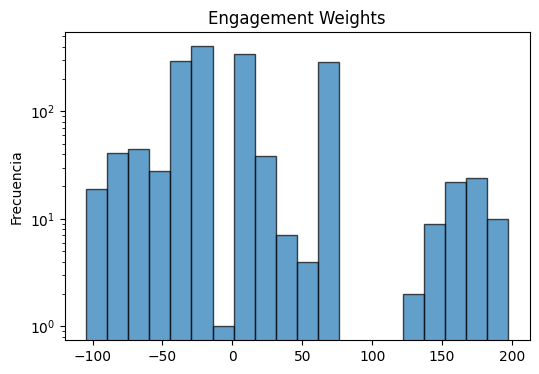

Media: 3.59
Desviación estándar: 53.71


In [56]:
plt.figure(figsize=(6, 4))
plt.hist(df['engagement_weights'], bins=20, edgecolor='black', alpha=0.7, log=True)
plt.title('Engagement Weights')
plt.ylabel('Frecuencia')
plt.show()

print(f"Media: {df['engagement_weights'].mean():.2f}")
print(f"Desviación estándar: {df['engagement_weights'].std():.2f}")

Podemos observar muchos valores negativos, lo que nos dice que para muchos puntos de interes los dislikes o falta de interacciones positivas son la mayoría. Y los que muestran un engagement alto (pocos) nos dice que son muy buenos. Así que las penalizaciones negativas superan las negativas. Y se necesita dominar el área para ajustar los pesos de forma correcta.


Nos quedamos con la segunda métrica "**Engagement Ratios**" dado que busca darle más valor a la calidad que al volumen. También penaliza los dislikes en relación a las interacciones positivas en vez de solo restarlos. Y nos tenemos que escalar los resultados.


In [57]:
# Eliminamos las columnas que creamos nuevas para las métricas y las que no son necesarias.
columnas_a_eliminar = ['engagement', 'likes_visits', 'bookmarks_visits', 'dislikes_positives', 'engagement_weights']
df = df.drop(columns=columnas_a_eliminar)


In [58]:
# Eliminamos las columnas con las que creamos nuestro engagament, nuestra variable objetivo.
columnas_a_eliminar = ['Visits', 'Likes', 'Dislikes', 'Bookmarks']
df = df.drop(columns=columnas_a_eliminar)

In [59]:
df.head(1).T

,0
locationLon,2.642262
locationLat,39.572694
xps,500
main_image_path,data_main/4b36a3ed-3b28-4bc7-b975-1d48b586db03...
total_tags,0
Arquitectura,0
Ciencia,0
Cine,0
Cultura,0
Escultura,1


In [60]:
# Vamos a dividir nuestro conjunto de datos del engagement en grupos donde tengan aproximadamente la misma cantidad de datos en cada grupo.
# Así tendremos un problema categórico, lo hacemos en 3 grupos: bajo, medio o alto.

engagement_scores = pd.qcut(df['engagement_ratios'], q=3, labels=[0,1,2])

In [61]:
engagement_scores

,engagement_ratios
0,0
1,2
2,2
3,2
4,1
...,...
1564,2
1565,1
1566,1
1567,2


In [64]:
#confirmamos que esten dentro de los valores esperados
engagement_scores.min()

np.int64(0)

In [65]:
engagement_scores.max()

np.int64(2)

In [66]:
# Vamos a guardar dichos valores en una nueva variable en nuestro dataframe.
df['engagement_scores'] = engagement_scores

<Axes: >

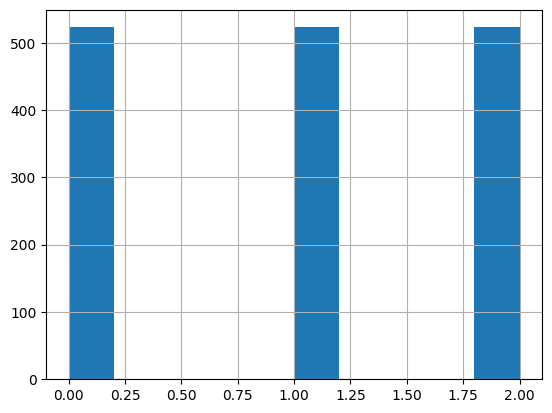

In [67]:
df.engagement_scores.hist()

In [68]:
df.engagement_scores.value_counts()

,count
engagement_scores,
0,523
1,523
2,523


In [69]:
# Podemos observar que nuestra variable esta balanceada.
# Ahora eliminaremos la variable 'engagement_ratios' dado que trabajaremos con 'engagement_scores'.
columnas_a_eliminar = ['engagement_ratios']
df = df.drop(columns=columnas_a_eliminar)


Visualicemos nuestros puntos de interes en un mapa.

In [70]:
#Crear un mapa centrado a la media de las coordenadas

center_lat = df['locationLat'].mean()
center_lon = df['locationLon'].mean()

map_center = [center_lat, center_lon]

mapa = folium.Map(location=map_center, zoom_start=10)

# Añadir los puntos al mapa
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['locationLat'], row['locationLon']],
        radius=6,
        fill=True,
        fill_opacity=0.7
    ).add_to(mapa)

mapa

Podriamos agruparlos para utilizar dicha variable en lugar de la latidud y la longitud, así ayudariamos a nuestra red.

Y después dicha variable la vamos a tratar como categórica.

In [71]:
from sklearn.cluster import KMeans

# Vamos a probar con 3 clusters
kmeans = KMeans(n_clusters=3, random_state=42)
df['cluster'] = kmeans.fit_predict(df[['locationLat', 'locationLon']])

In [72]:

# Definir colores para los clusters
num_clusters = len(df['cluster'].unique())
colormap = cm.get_cmap('tab10', num_clusters)
colors = [mcolors.to_hex(colormap(i)) for i in range(num_clusters)]

# Añadir los puntos al mapa
for _, row in df.iterrows():
    cluster = row['cluster']
    color = colors[cluster] if cluster != -1 else 'gray'  # Color gris para ruido
    folium.CircleMarker(
        location=[row['locationLat'], row['locationLon']],
        radius=6,
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=f"Cluster {cluster}"
    ).add_to(mapa)

mapa

/tmp/ipython-input-72-2641018868.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap('tab10', num_clusters)


In [73]:
# Probemos con 4 clusters
kmeans = KMeans(n_clusters=4, random_state=42)
df['cluster'] = kmeans.fit_predict(df[['locationLat', 'locationLon']])

In [74]:
#Crear un mapa centrado a la media de las coordenadas

# Definir colores para los clusters
num_clusters = len(df['cluster'].unique())
colormap = cm.get_cmap('tab10', num_clusters)
colors = [mcolors.to_hex(colormap(i)) for i in range(num_clusters)]

# Añadir los puntos al mapa
for _, row in df.iterrows():
    cluster = row['cluster']
    color = colors[cluster] if cluster != -1 else 'gray'  # Color gris para ruido
    folium.CircleMarker(
        location=[row['locationLat'], row['locationLon']],
        radius=6,
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=f"Cluster {cluster}"
    ).add_to(mapa)

mapa

/tmp/ipython-input-74-2440608380.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap('tab10', num_clusters)


In [75]:
# Probemos con 5 clusters
kmeans = KMeans(n_clusters=5, random_state=42)
df['cluster'] = kmeans.fit_predict(df[['locationLat', 'locationLon']])

In [76]:
#Crear un mapa centrado a la media de las coordenadas

# Definir colores para los clusters
num_clusters = len(df['cluster'].unique())
colormap = cm.get_cmap('tab10', num_clusters)
colors = [mcolors.to_hex(colormap(i)) for i in range(num_clusters)]

# Añadir los puntos al mapa
for _, row in df.iterrows():
    cluster = row['cluster']
    color = colors[cluster] if cluster != -1 else 'gray'  # Color gris para ruido
    folium.CircleMarker(
        location=[row['locationLat'], row['locationLon']],
        radius=6,
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=f"Cluster {cluster}"
    ).add_to(mapa)

mapa

/tmp/ipython-input-76-2440608380.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colormap = cm.get_cmap('tab10', num_clusters)


Me voy a quedar con esta cantidad de cluster, dado que con siento que se realiza una buena diferencia entre Europa y Asia con respeto a 3 clusters.
Y en comparación con 5 clusters no nos divide América.

Procedemos a

In [77]:
# Nos quedamos con 4 clusters
kmeans = KMeans(n_clusters=4, random_state=42)
df['cluster'] = kmeans.fit_predict(df[['locationLat', 'locationLon']])

In [78]:
# Vamos a mapear los valores existentes de 'cluster' a enteros consecutivos empezando desde 0 y los reemplazamos por los existentes
cluster_mapping = {cluster: i for i, cluster in enumerate(sorted(df['cluster'].unique()))}
df['cluster'] = df['cluster'].map(cluster_mapping)

# Aplicamos one-hot encoding, debemos pasar a tensor y luego lo volvemos a transormar en un array de numpy
one_hot_encoded_cluster = torch.nn.functional.one_hot(torch.tensor(df['cluster'].values), num_classes=len(df['cluster'].unique())).numpy()

# Tenemos que crear los nombres de las nuevas columnas para el one-hot encoding de "tier" ('tier_0', 'tier_1', ...)
cluster_columns = [f'cluster_{i}' for i in sorted(df['cluster'].unique())]

one_hot_cluster_df = pd.DataFrame(one_hot_encoded_cluster, columns=cluster_columns, index=df.index)

# Concatenamos con el dataframe original
df = pd.concat([df, one_hot_cluster_df], axis=1)

In [79]:
# Comprobemos
df.head(1).T

,0
locationLon,2.642262
locationLat,39.572694
xps,500
main_image_path,data_main/4b36a3ed-3b28-4bc7-b975-1d48b586db03...
total_tags,0
Arquitectura,0
Ciencia,0
Cine,0
Cultura,0
Escultura,1


In [80]:
# Pasemos a eliminar las vairables de latitud y longitud dado que trabajaremos con el nueva variable cluster
columnas_a_eliminar = ['locationLat','locationLon','cluster']
df = df.drop(columns=columnas_a_eliminar)


In [81]:
#Vamos a visualizar los max y min de xps
print("\nRango de xps:", df['xps'].min(), "-", df['xps'].max())


Rango de xps: 0 - 1000


In [82]:
#Vamos a visualizar los max y min de xps
print("\nRango de total_tags:", df['total_tags'].min(), "-", df['total_tags'].max())


Rango de total_tags: 0 - 13


Podemos observar la corelacción que existen entre nuestra variables.

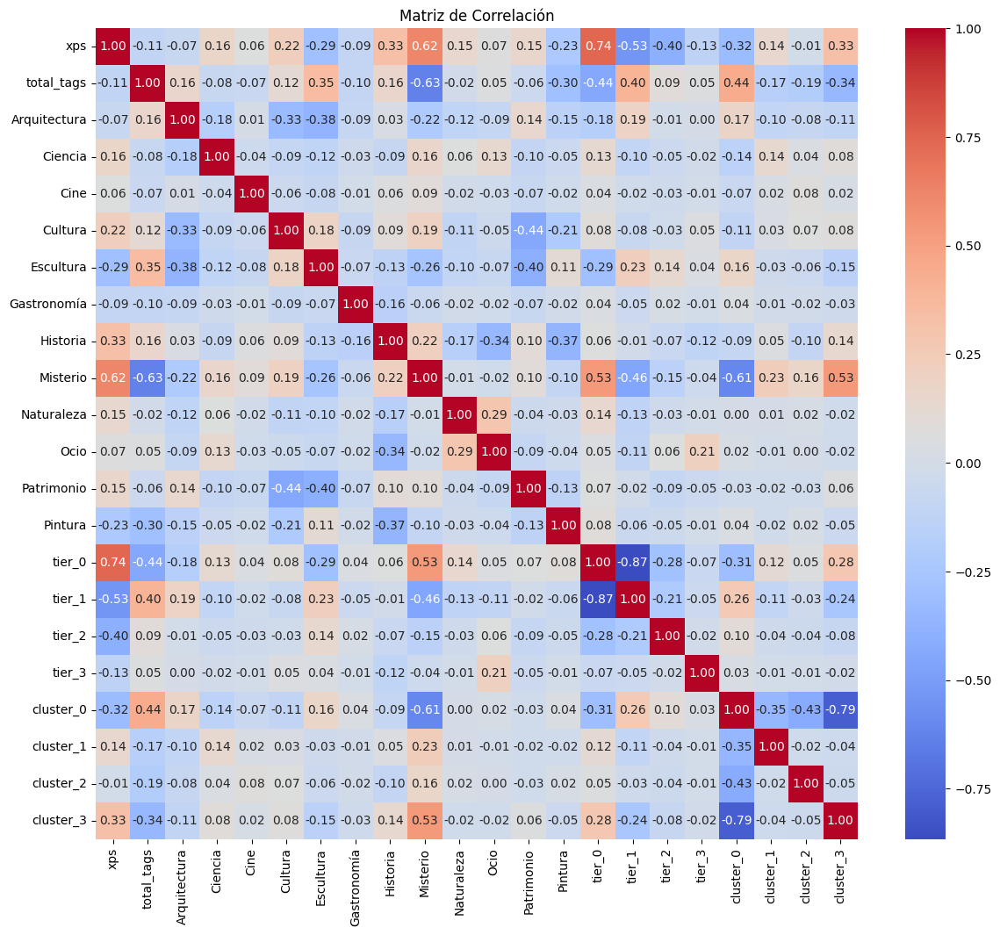

In [83]:
corr_matrix = df.corr(numeric_only=True)
plt.figure(figsize = (14,12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Matriz de Correlación')
plt.show()

In [96]:
df.head(5).T

,0,1,2,3,4
xps,500,500,250,500,500
main_image_path,data_main/4b36a3ed-3b28-4bc7-b975-1d48b586db03...,data_main/e32b3603-a94f-49df-8b31-92445a86377c...,data_main/0123a69b-13ac-4b65-a5d5-71a95560cff5...,data_main/390d7d9e-e972-451c-b5e4-f494af15e788...,data_main/023fc1bf-a1cd-4b9f-af78-48792ab1a294...
total_tags,0,0,0,0,0
Arquitectura,0,0,0,0,0
Ciencia,0,0,1,0,0
Cine,0,0,0,0,0
Cultura,0,0,0,1,1
Escultura,1,0,0,0,0
Gastronomía,0,0,0,0,0
Historia,0,1,0,0,0


# Imágenes

Empecemos explorando nuestras imágenes.


In [84]:
ruta_imgs = "/content/drive/MyDrive/Colab Notebooks/datos/"

In [85]:
image_path = ruta_imgs+df.main_image_path[0]
image = cv2.imread(image_path)

image.shape

(128, 128, 3)

In [86]:
random_images = df.sample(n=30)

for idx, (_,row) in enumerate(random_images.iterrows()):
  image_path = ruta_imgs+row['main_image_path']
  image = cv2.imread(image_path)

  if image is None:
    print(f"Warning: No se puede cargar la imagen en la ruta: {image_path}")
    # Skip processing this image and move to the next one
    continue

  print(image.shape)

(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)
(128, 128, 3)


Podemos observar que la imagen es de 128 x 128 y a color porque tiene 3 dimensiones. Por lo tanto sus valores van entre 0  y 255

Vamos a comprar si todas son iguales.

In [199]:
#vamos a confirmar si todas tienen el mismo tamaño.
df.main_image_path.apply(lambda x: cv2.imread(ruta_imgs+x).shape)

,main_image_path
0,"(128, 128, 3)"
1,"(128, 128, 3)"
2,"(128, 128, 3)"
3,"(128, 128, 3)"
4,"(128, 128, 3)"
...,...
1564,"(128, 128, 3)"
1565,"(128, 128, 3)"
1566,"(128, 128, 3)"
1567,"(128, 128, 3)"


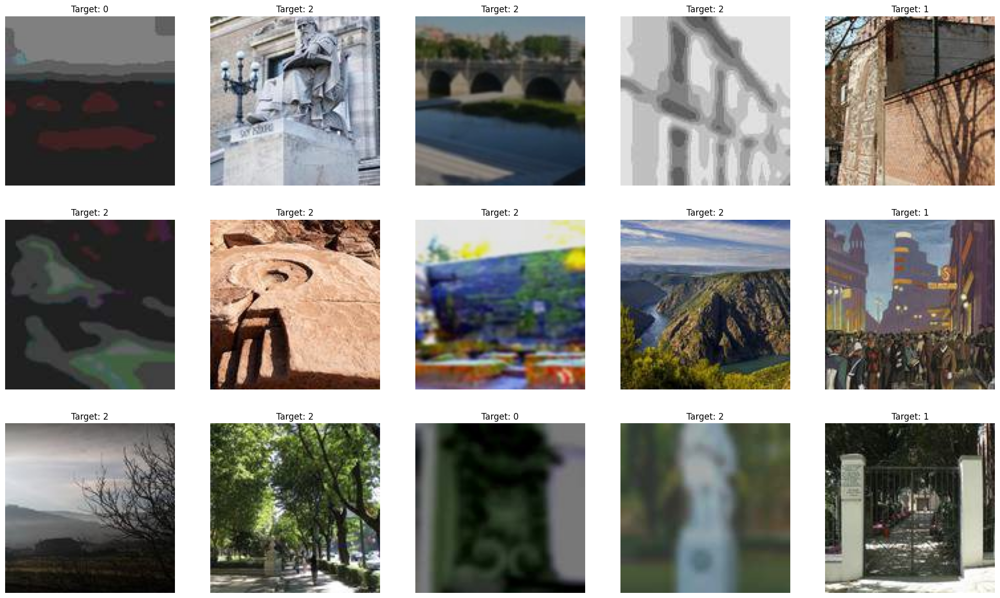

In [88]:
# Mostraemos solo 10 imágenes al azar
random_images = df.sample(n=15)

plt.figure(figsize=(25,25))

for idx, (_,row) in enumerate(random_images.iterrows()):
  image_path = ruta_imgs+row['main_image_path']
  image = cv2.imread(image_path)


  if image is None:
    print(f"Warning: No se puede cargar la imagen en la ruta: {image_path}")
    # Skip processing this image and move to the next one
    continue

  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  plt.subplot(5,5,idx+1)
  plt.imshow(image)
  plt.title(f"Target: {df.engagement_scores[idx]}")
  plt.axis('off')

plt.show()

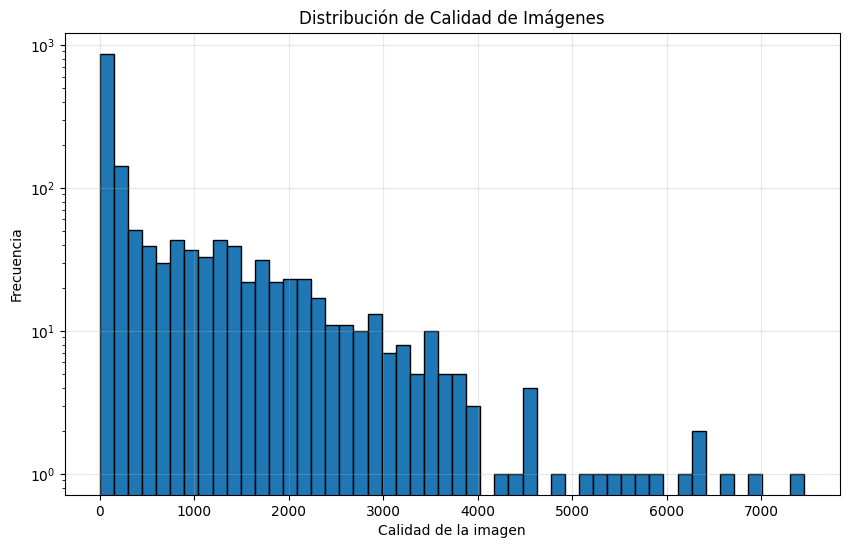

In [107]:
#Analizamos la calidad de las imágenes calculando el contraste y la nitidez

image_quality = []

for idx, (_,row) in enumerate(df.iterrows()):
  image_path = ruta_imgs+row['main_image_path']
  image = cv2.imread(image_path)

  if image is None:
    print(f"Warning: No se puede cargar la imagen en la ruta: {image_path}")
    # Skip processing this image and move to the next one
    continue

  img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  #Calculamos el contraste (desviación estándar)
  contrast = np.std(img_gray)

  #Calculamos la nitidez usando Laplaciano
  laplacian = cv2.Laplacian(img_gray, cv2.CV_64F)
  sharpness = np.var(laplacian)

  #combinamos las metricas en un score
  quality_score = (contrast + sharpness) / 2

  image_quality.append(quality_score)

#creamos el histograma
plt.figure(figsize=(10,6))
plt.hist(image_quality, bins=50, edgecolor='black', log=True)
plt.title('Distribución de Calidad de Imágenes')
plt.xlabel('Calidad de la imagen')
plt.ylabel('Frecuencia')
plt.grid(True, alpha=0.3)
plt.show()



Podemos observar en las imagenes de ejemplo que cuenta con diferente calidad, mostrando un pico importante con pesima calidad.


# **Preprocesamiento de imágenes**

In [197]:
img_size = (224, 224)

# Necesitamos preprocesar nuestra imagenes
# Primero necesitamos pasar a formato RGB para tener el orden correcto
# Redimensionarls y normalizarlas pasandolas a tensor.
# Al pasar a tensor convierte la imagen a un tensor de tipo float32 y escala los valores de píxel dividiéndolos por 255,
#es decir pasando de enteros 0–255 a flotantes 0.0–1.0.

def image_preprocessing(path):

    imgen = cv2.imread(ruta_imgs + path)
    imgen = cv2.cvtColor(imgen, cv2.COLOR_BGR2RGB)
    imgen = cv2.resize(imgen, img_size)
    transforms.ToTensor()
    return imgen


# Necesitamos 2 arreglos X para nuestras imagenes y y para el target
# Inicializamos a ceros X donde le decimos el numero de imagenes, la altura y ancho de casa imagen y loss canales (3 a color)
X = np.zeros((len(df), img_size[0], img_size[1], 3))
y = df['engagement_scores'].values

# Vamos a guardar nuestra imagenes preprocesdas en X
for idx, row in df.iterrows():
    X[idx] = image_preprocessing(row['main_image_path'])

# Confirmemos los tamaños
print("X:", X.shape)
print("y:", y.shape)


X: (1569, 224, 224, 3)
y: (1569,)


In [198]:
print("\nRango de las imagenes:", X.min(), "-", X.max())


Rango de las imagenes: 0.0 - 255.0


# Dataset personalizado y DataLoaders

In [91]:
# Vamos a definir nuestra semilla para poder replicar el proyecto

def set_random_seed(seed):
  random.seed(seed)
  np.random.seed(seed)
  torch.manual_seed(seed)

  # Semilla para CUDA si está disponible
  if torch.cuda.is_available():
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

  torch.backends.cudnn.deterministic = True
  torch.backends.cudnn.benchmark = False

seed = 42
set_random_seed(seed)

In [92]:
# Dividimos nuestros datos en train y test
# con nuestra semilla y mantendremos la distribución de clases balanceada en engagement_scores
# 85% train y 15% test
train_df0, test_df = train_test_split(df, test_size=0.15, random_state=seed, stratify=df.engagement_scores)

# Dividimos los datos de train en train y validation
# con nuestra semilla y mantendremos la distribución de clases balanceada en engagement_scores
# 85% train y 15% validacion
train_df, val_df = train_test_split(train_df0, test_size=0.15, random_state=seed, stratify=train_df0.engagement_scores)

print(f"Tamaño inicial del DF: {len(df)}")
print(f"Tamaño del DF de entrenamiento: {len(train_df)}")
print(f"Tamaño del DF de validación: {len(val_df)}")
print(f"Tamaño del DF de test: {len(test_df)}")

Tamaño inicial del DF: 1569
Tamaño del DF de entrenamiento: 1133
Tamaño del DF de validación: 200
Tamaño del DF de test: 236


In [103]:
# Lo quiero a 224 porque la arquitectura que quiero usar para la CNN es ResNet y es el tamaño con el que han sido pre-entrenada.
img_size = (224, 224)

# Necesitamos calcular la media y desviación estandar de nuestro conjunto de datos de entrenamiento para aplicarla en nuestros DataLoader
# con esto vamos a evitar "Data Leakage", es decir fuga de información.

# Vamos a crearun función porque la vamos a utilizar varias veces

def calculate_mean_std(df, img_size):

  transforms_tensor = transforms.Compose([
    transforms.Resize(img_size),
    transforms.ToTensor()
  ])

  image_tensors = []


  for path in df['main_image_path']:
    image = cv2.imread(ruta_imgs + path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = Image.fromarray(image)

    tensor_img = transforms_tensor(image)
    image_tensors.append(tensor_img)

  train_data = torch.stack(image_tensors).to(device)

  # Calcula media y std para poder aplicarla a nuestros conjuntos de datos en al transformación de imágenes..
  mean = train_data.mean()
  std = train_data.std()

  return mean, std

mean_train, std_train = calculate_mean_std(train_df, img_size)

print(f"Media del conjunto de entrenamiento: {mean_train.tolist()}")
print(f"Desviación estándar del conjunto de entrenamiento: {std_train.tolist()}")

Media del conjunto de entrenamiento: 0.43927475810050964
Desviación estándar del conjunto de entrenamiento: 0.26631322503089905


In [94]:
# Instancia global del StandardScaler.
#El StandardScaler transforma los datos para que tengan una media de 0 y una desviación estándar de 1.
global_scaler = StandardScaler()

In [95]:
def process_features(features_df, is_training=True):

  df_processed = features_df.copy()

  #Como tiene valores muy altos vamos a trabajar en base logaritmica.
  if 'xps' in df_processed.columns:
        df_processed['xps'] = np.log1p(df_processed['xps'])

  # Instancia global del StandardScaler.
  global global_scaler

  if is_training:
      # Como estamos con el conjunto de entrenamiento vamos entrenar y transformar
      features_scaled = global_scaler.fit_transform(features_df)

  else:
    # Como no estamos con el conjunto de datos de entrenamiento solo debemos transformar.
      features_scaled = global_scaler.transform(features_df)

  # Crea un nuevo DataFrame con los datos escalados y los mismos nombres de columna
  features_scaled_df = pd.DataFrame(features_scaled, columns=features_df.columns, index=features_df.index)

  return features_scaled_df

In [99]:
#Necesitamos escalar algunas variables de nuestros metadatos.

# Lista de columnas a incluir, son solo las que necesitan ser escalonadas.
incluir = ['xps', 'total_tags']
numeric_cols = [col for col in df.columns if col in incluir]

# Procesar datos de entrenamiento
# Concatenar las características escaladas de vuelta al DataFrame de entrenamiento
train_features_scaled = process_features(train_df[numeric_cols], is_training=True)
train_df = pd.concat([train_df.drop(columns=numeric_cols), train_features_scaled], axis=1)

# Procesar datos de validación
val_features_scaled = process_features(val_df[numeric_cols], is_training=False)
val_df = pd.concat([val_df.drop(columns=numeric_cols), val_features_scaled], axis=1)

# Procesar datos de test
test_features_scaled = process_features(test_df[numeric_cols], is_training=False)
test_df = pd.concat([test_df.drop(columns=numeric_cols), test_features_scaled], axis=1)

print("Características numéricas escaladas para cada división.")
print("Cabeza del DataFrame de entrenamiento procesado:")
print(train_df.head())
print("-" * 50)


Características numéricas escaladas para cada división.
Cabeza del DataFrame de entrenamiento procesado:
                                        main_image_path  Arquitectura  \
1369  data_main/04c4b257-4285-411a-a07a-9987378d993e...             1   
144   data_main/1e0f97de-3c5e-4f74-914f-b311ce80b11c...             1   
848   data_main/42e3dd8c-f6fb-455f-af0c-034dc420cb7a...             0   
1184  data_main/47d46d37-982e-4258-8c4a-5df7869d7df9...             0   
522   data_main/b5e9a237-b99a-406b-bb58-71643a809083...             0   

      Ciencia  Cine  Cultura  Escultura  Gastronomía  Historia  Misterio  \
1369        0     0        0          0            0         1         1   
144         0     0        1          0            0         1         0   
848         0     0        1          1            0         1         0   
1184        0     0        1          0            0         1         1   
522         0     0        1          1            0         1         0   


/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.11/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [100]:
#Vamos a visualizar los max y min de xps
print("\nRango de xps:", train_df['xps'].min(), "-", train_df['xps'].max())


Rango de xps: -3.354153871473131 - 1.092670767397753


In [101]:
#Vamos a visualizar los max y min de xps
print("\nRango de total_tags:", train_df['total_tags'].min(), "-", train_df['total_tags'].max())


Rango de total_tags: -1.8928502497762756 - 0.9804663872385408


In [104]:
# Definimos transformaciones finales para validación y test a nuestra imágenes
image_transform_test_val = transforms.Compose([
    transforms.Resize(img_size),
    transforms.ToTensor(),
    #Con la media y desviación estandar que calculamos del conjunto de datos de entrenamiento
    transforms.Normalize(mean=mean_train, std=std_train)
])


In [105]:
# Definimos las transformaciones finales para entrenamiento (con data augmentation)
image_transform_train = transforms.Compose([
    transforms.Resize(img_size),
    # Invertimos la imagen horizontalmente de izquierda a derecha.
    transforms.RandomHorizontalFlip(p=0.5),
    # Aplicamos variaciones aleatorias de color a la imagen. Con esto ayudamos al modelo a que sea más robusto a condiciones de iluminación y colores diferentes.
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    # Rotación aleatoria hasta +/- 10 grados
    transforms.RandomRotation(degrees=10), # Rotación aleatoria hasta +/- 10 grados
    # Aplica una traslación, es decir mueve la imagen horizontal y verticalmente un 10%
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.ToTensor(),
    #Con la media y desviación estandar que calculamos del conjunto de datos de entrenamiento
    transforms.Normalize(mean=mean_train, std=std_train)
])

Crearemos una clase personalizada para nuestro Dataset.

In [106]:
# Vamos crear una clase personalizada para procesar el dataset.

class POIDataset(Dataset):

  # Función de inicialización
  def __init__(self, features, image_path, target, is_training=False):

    self.feature_cols = features.columns
    self.features = torch.tensor(features.values, dtype=torch.float32)
    self.target = torch.LongTensor(target) #Para que no nos de problemas con el float32
    self.image_dir = image_path
    self.is_training = is_training


  # Función para obtener el tamaño del dataframe
  def __len__(self):
    return len(self.features)


  # Función para obter la imagen
  def __getitem__(self, idx):

    # Obtener el target
    target = self.target[idx].to(device)

    # Obtener las features
    features = self.features[idx].to(device)

    # Cargar y transformar la imagen
    path_img = ruta_imgs + self.image_dir[idx]
    image = cv2.imread(path_img)

    if image is None: # Comprobar si cv2.imread falló
        raise FileNotFoundError(f"No se pudo cargar la imagen: {path_img}. Verifica la integridad del archivo.")
        dummy_image = np.zeros((224, 224, 3), dtype=np.uint8)
        imgen = dummy_image

    # Convertir la imagen de OpenCV (array NumPy) a una imagen PIL
    image = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    # Aplicar la transformación de imagen según si es entrenamiento o no
    if self.is_training:
        image = image_transform_train(image).to(device)
    else:
        image = image_transform_test_val(image).to(device)

    return features, image, target

In [108]:
#Creamos un dataset para cada conjunto de datos

train_dataset = POIDataset(features=train_df.drop(columns=['engagement_scores', 'main_image_path']),
                           image_path=df.main_image_path,
                           target=df.engagement_scores,
                           is_training=True)

val_dataset = POIDataset(features=val_df.drop(columns=['engagement_scores', 'main_image_path']),
                         image_path=df.main_image_path,
                         target=df.engagement_scores,
                         is_training=False)

test_dataset = POIDataset(features=test_df.drop(columns=['engagement_scores', 'main_image_path']),
                          image_path=df.main_image_path,
                          target=df.engagement_scores,
                          is_training=False)


In [109]:
# Vamos a verificar los tamaños de los 3 dataset
# Comprobemos train
features_train, image_train, target_train = train_dataset[0]
print(f"Tamaño features train: {features_train.shape}")
print(f"Tamaño imagen train: {image_train.shape}")
print(f"Tamaño target train: {target_train.shape if len(target_train.shape) > 0 else (1)}")

Tamaño features train: torch.Size([22])
Tamaño imagen train: torch.Size([3, 224, 224])
Tamaño target train: 1


In [110]:
# Comprobemos un validation
features_val, image_val, target_val = val_dataset[0]
print(f"Tamaño features validation: {features_val.shape}")
print(f"Tamaño imagen validation: {image_val.shape}")
print(f"Tamaño target validation: {target_val.shape if len(target_val.shape) > 0 else (1)}")

Tamaño features validation: torch.Size([22])
Tamaño imagen validation: torch.Size([3, 224, 224])
Tamaño target validation: 1


In [111]:
# Comprobemos un test
features_test, image_test, target_test = test_dataset[0]
print(f"Tamaño features validation: {features_test.shape}")
print(f"Tamaño imagen validation: {image_test.shape}")
print(f"Tamaño target validation: {target_test.shape if len(target_test.shape) > 0 else (1)}")

Tamaño features validation: torch.Size([22])
Tamaño imagen validation: torch.Size([3, 224, 224])
Tamaño target validation: 1


In [112]:
# Veamos que tienen
features_train

tensor([ 1.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  1.0000,  1.0000,
         0.0000,  0.0000,  1.0000,  0.0000,  1.0000,  0.0000,  0.0000,  0.0000,
         0.0000,  0.0000,  0.0000,  1.0000,  1.0927, -0.7877], device='cuda:0')

In [113]:
image_train

tensor([[[-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         [-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         [-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         ...,
         [ 1.6343,  1.6196,  1.6048,  ..., -1.6495, -1.6495, -1.6495],
         [ 1.6196,  1.6048,  1.5901,  ..., -1.6495, -1.6495, -1.6495],
         [ 1.6048,  1.5901,  1.5754,  ..., -1.6495, -1.6495, -1.6495]],

        [[-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         [-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         [-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         ...,
         [ 1.6637,  1.6637,  1.6490,  ..., -1.6495, -1.6495, -1.6495],
         [ 1.6490,  1.6490,  1.6343,  ..., -1.6495, -1.6495, -1.6495],
         [ 1.6343,  1.6343,  1.6196,  ..., -1.6495, -1.6495, -1.6495]],

        [[-1.6495, -1.6495, -1.6495,  ..., -1.6495, -1.6495, -1.6495],
         [-1.6495, -1.6495, -1.6495,  ..., -1

In [114]:
target_train

tensor(0, device='cuda:0')

# Arquitectura del Modelo

In [115]:
class NetEngagementPOI(nn.Module):
    def __init__(self, input_size=22, num_classes=3, dropout_rate=0.4, freeze_layers=5):

        super(NetEngagementPOI, self).__init__()

        # Para nuestra features trabajaremos con capas full connected
        self.features_fc = nn.Sequential(

          # Primera Capa full connected
          # BatchNorm1d nos ayuda normalizar la salida de la capa antrior y acelerar el entrenamiento.
          # Función de activación Relu dado que para en general funicona muy bien para clasificación.
          # Ayuda con el problema del gradiente que tiende a desaparecer
          # Dropout para reducir el sobreajuste (overfitting). Nos ayuda a generalizar.
          nn.Linear(input_size, 64),
          nn.BatchNorm1d(64),
          nn.ReLU(),
          nn.Dropout(dropout_rate),

          # Segunda Capa full connected
          nn.Linear(64, 32),
          nn.BatchNorm1d(32),
          nn.ReLU(),
          nn.Dropout(dropout_rate)

        )

        # Para nuestra imágenes como no tiene buena calidad ni tenemos muchos datos,
        # vamos a provechar la arquitectura de ResNet-18
        # Cagamos el modelo pre-entrenado
        resnet18 = torchvision.models.resnet18(weights=models.ResNet18_Weights.DEFAULT)

        # Necesitamos congelar capas (Transfer Learning)
        # freeze_layers = cuántas capas iniciales se van a congelar para así tengamos
        # una red mas robusta dado que protege las lo aprendido en las capas congeladas.
        for param in list(resnet18.parameters())[:freeze_layers]:
            param.requires_grad = False # No queremos que actualice los pesos de estas capas (congelarlas)

        # Para nuestra imagenes trabajaremos con CNN
        self.images_cnn = nn.Sequential(
            # Tenemos que eliminar la última capa, que es el clasificador para ResNet que nosotros no vamos a usar
            *list(resnet18.children())[:-1],
            # Aplanamos la salida para poder combinarla.
            nn.Flatten()
        )

        # Obtener el tamaño de salida de la CNN después de Flatten.
        with torch.no_grad(): # No calcular gradientes porque solo vamos a comprabar el la salida de CNN
            ejem_image_input = torch.randn(1, 3, 224, 224)
            cnn_output_dim = self.images_cnn(ejem_image_input).shape[1]
            print(f"Dimensión de salida de images_cnn: {cnn_output_dim}")

        # Red final combinando la de features y la de imagenes y con el clasificador final
        # La salida de features_fc = 32.
        # La salida de images_cnn = 512 deberia de ser porque es lo que saca ResNet18.
        final_input_size = 32 + cnn_output_dim

        self.engagement_classifier = nn.Sequential(
            nn.Linear(final_input_size, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(64, num_classes) # Capa de salida para 3 clases
        )

        #Inicialización de pesos y bias
        self.apply(self._initialize_weights_kaiming)

    #Función para inicializar los peos y bias en nuestras capas full connected
    def _initialize_weights_kaiming(self, m):
        if isinstance(m, nn.Linear):
          # Utilizamos a Kaiming normal porque va muy bien con la función de activación Relu.
          # Logra tener un entrenamiento más rapido dado que previene los probelmas del gradiente que desaparece.
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            # Y si tiene bias los inicialemos con cero para que no se introduzca un sesgo en las activaciones.
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

    def forward(self, features, images):

        # Pasar las features por la red fc
        features_output = self.features_fc(features)

        # Pasar las imágenes por la CNN
        images_output = self.images_cnn(images)

        # Concatenar las salidas de ambas redes
        # Dim=1 para poder mantener la dimensión del batch.
        output = torch.cat((features_output, images_output), dim=1)

        # Pasar la salida combinada por el clasificador final
        final_output = self.engagement_classifier(output)

        return final_output



- Vamos a crear otra arquitectura de nuestra red para compararla con la anterior.

In [116]:
class NetEngagementPOIProfunda(nn.Module):
    def __init__(self, input_size=22, num_classes=3, dropout_rate=0.4, freeze_layers=5):

        super(NetEngagementPOIProfunda, self).__init__()

        # Para nuestra features trabajaremos con capas full connected
        self.features_fc = nn.Sequential(

          # Primera Capa full connected
          # BatchNorm1d nos ayuda normalizar la salida de la capa antrior y acelerar el entrenamiento.
          # Función de activación Relu dado que para en general funicona muy bien para clasificación.
          # Ayuda con el problema del gradiente que tiende a desaparecer
          # Dropout para reducir el sobreajuste (overfitting). Nos ayuda a generalizar.
          nn.Linear(input_size, 128),
          nn.BatchNorm1d(128),
          nn.ReLU(),
          nn.Dropout(dropout_rate),

          # Segunda Capa full connected
          nn.Linear(128, 64),
          nn.BatchNorm1d(64),
          nn.ReLU(),
          nn.Dropout(dropout_rate),

          # Tercer Capa full connected
          nn.Linear(64, 32),
          nn.BatchNorm1d(32),
          nn.ReLU(),
          nn.Dropout(dropout_rate),
        )

        # Para nuestra imágenes como no tiene buena calidad ni tenemos muchos datos,
        # vamos a provechar ahora con la arquitectura de ResNet-50 que es más profunda
        # Cagamos el modelo pre-entrenado
        resnet50 = torchvision.models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

        # Necesitamos congelar capas (Transfer Learning)
        # freeze_layers = cuántas capas iniciales se van a congelar para así tengamos una
        # red mas robusta dado que protege las lo aprendido en las capas congeladas.
        for param in list(resnet50.parameters())[:freeze_layers]:
            param.requires_grad = False # No queremos que actualice los pesos de estas capas (congelarlas)

        # Para nuestra imagenes trabajaremos con CNN
        self.images_cnn = nn.Sequential(
            # Tenemos que eliminar la última capa, que es el clasificador para ResNet que nosotros no vamos a usar
            *list(resnet50.children())[:-1],
            # Aplanamos la salida para poder combinarla.
            nn.Flatten()
        )

        # Obtener el tamaño de salida de la CNN después de Flatten.
        with torch.no_grad(): # No calcular gradientes porque solo vamos a comprabar el la salida de CNN
            ejem_image_input = torch.randn(1, 3, 224, 224)
            cnn_output_dim = self.images_cnn(ejem_image_input).shape[1]
            print(f"Dimensión de salida de images_cnn: {cnn_output_dim}")

        # Red final combinando la de features y la de imagenes y con el clasificador final
        # La salida de features_fc = 32.
        # La salida de images_cnn = 2048 deberia de ser porque es lo que saca ResNet50.
        final_input_size = 32 + cnn_output_dim

        self.engagement_classifier = nn.Sequential(
            nn.Linear(final_input_size, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(64, 32),
            nn.BatchNorm1d(32),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(32, num_classes) # Capa de salida para 3 clases
        )

        #Inicialización de pesos y bias
        self.apply(self._initialize_weights_kaiming)

    #Función para inicializar los peos y bias en nuestras capas full connected
    def _initialize_weights_kaiming(self, m):
        if isinstance(m, nn.Linear):
          # Utilizamos a Kaiming normal porque va muy bien con la función de activación Relu.
          # Logra tener un entrenamiento más rapido dado que previene los probelmas del gradiente que desaparece.
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            # Y si tiene bias los inicialemos con cero para que no se introduzca un sesgo en las activaciones.
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

    def forward(self, features, images):

        # Pasar las features por la red fc
        features_output = self.features_fc(features)

        # Pasar las imágenes por la CNN
        images_output = self.images_cnn(images)

        # Concatenar las salidas de ambas redes
        # Dim=1 para poder mantener la dimensión del batch.
        output = torch.cat((features_output, images_output), dim=1)

        # Pasar la salida combinada por el clasificador final
        final_output = self.engagement_classifier(output)

        return final_output



- Por último vamos a crear una arquitectura mas sencilla en las full connected y con ResNet50

In [117]:
class NetEngagementPOIMix(nn.Module):
    def __init__(self, input_size=22, num_classes=3, dropout_rate=0.4, freeze_layers=5):

        super(NetEngagementPOIMix, self).__init__()

        # Para nuestra features trabajaremos con capas full connected
        self.features_fc = nn.Sequential(

          # Primera Capa full connected
          # BatchNorm1d nos ayuda normalizar la salida de la capa antrior y acelerar el entrenamiento.
          # Función de activación Relu dado que para en general funicona muy bien para clasificación.
          # Ayuda con el problema del gradiente que tiende a desaparecer
          # Dropout para reducir el sobreajuste (overfitting). Nos ayuda a generalizar.
          nn.Linear(input_size, 32),
          nn.BatchNorm1d(32),
          nn.ReLU(),
          nn.Dropout(dropout_rate)
        )

        # Para nuestra imágenes como no tiene buena calidad ni tenemos muchos datos,
        # vamos a provechar ahora con la arquitectura de ResNet-50 que es más profunda
        # Cagamos el modelo pre-entrenado
        resnet50 = torchvision.models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

        # Necesitamos congelar capas (Transfer Learning)
        # freeze_layers = cuántas capas iniciales se van a congelar para así tengamos
        # una red mas robusta dado que protege las lo aprendido en las capas congeladas.
        for param in list(resnet50.parameters())[:freeze_layers]:
            param.requires_grad = False # No queremos que actualice los pesos de estas capas (congelarlas)

        # Para nuestra imagenes trabajaremos con CNN
        self.images_cnn = nn.Sequential(
            # Tenemos que eliminar la última capa, que es el clasificador para ResNet que nosotros no vamos a usar
            *list(resnet50.children())[:-1],
            # Aplanamos la salida para poder combinarla.
            nn.Flatten()
        )

        # Obtener el tamaño de salida de la CNN después de Flatten.
        with torch.no_grad(): # No calcular gradientes porque solo vamos a comprabar el la salida de CNN
            ejem_image_input = torch.randn(1, 3, 224, 224)
            cnn_output_dim = self.images_cnn(ejem_image_input).shape[1]
            print(f"Dimensión de salida de images_cnn: {cnn_output_dim}")

        # Red final combinando la de features y la de imagenes y con el clasificador final
        # La salida de features_fc = 32.
        # La salida de images_cnn = 2048 deberia de ser porque es lo que saca ResNet50.
        final_input_size = 32 + cnn_output_dim

        self.engagement_classifier = nn.Sequential(
            nn.Linear(final_input_size, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(64, 32),
            nn.BatchNorm1d(32),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(32, num_classes) # Capa de salida para 3 clases
        )

        #Inicialización de pesos y bias
        self.apply(self._initialize_weights_kaiming)

    #Función para inicializar los peos y bias en nuestras capas full connected
    def _initialize_weights_kaiming(self, m):
        if isinstance(m, nn.Linear):
          # Utilizamos a Kaiming normal porque va muy bien con la función de activación Relu.
          # Logra tener un entrenamiento más rapido dado que previene los probelmas del gradiente que desaparece.
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            # Y si tiene bias los inicialemos con cero para que no se introduzca un sesgo en las activaciones.
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

    def forward(self, features, images):

        # Pasar las features por la red fc
        features_output = self.features_fc(features)

        # Pasar las imágenes por la CNN
        images_output = self.images_cnn(images)

        # Concatenar las salidas de ambas redes
        # Dim=1 para poder mantener la dimensión del batch.
        output = torch.cat((features_output, images_output), dim=1)

        # Pasar la salida combinada por el clasificador final
        final_output = self.engagement_classifier(output)

        return final_output



# Entrenamientos y Optimización

*   Entrenamiento a las diferentes arquitecturas.
*   De ser necesario creación de una cuarta basandonos en los resultados.
*   Optimización de algunos hiperparámetros.
*   Pruebas cambiando número de épocas o bach size.


In [132]:
# Empecemos por definir nuestra función de entrenamiento

def train_model(trial, model, train_loader, val_loader, test_loader):

    # Definimos parametros

    batch_size = 32 # Tamaño del batch
    learning_rate = 0.001 #Tasa de aprendizaje
    num_epochs = 10   # Épocas
    weight_decay = 1e-4  # Regularización L2
    patience = 5  # Early Stopping

    model_path = f'best_models'
    os.makedirs(model_path, exist_ok=True)

    print("\nParámetros seleccionados:")
    print(f"   - Batch Size: {batch_size}")
    print(f"   - Tamaño de Features: {input_size}")
    print(f"   - Clases engagement: {num_classes}")
    print(f"   - Numero de Freeze Layers: {freeze_layers}")
    print(f"   - Dropout Rate: {dropout_rate:.3f}")
    print(f"   - Learning Rate: {learning_rate:.6f}")
    print(f"   - Epocas: {num_epochs}")
    print(f"   - Early Stopping cada: {patience}")
    print(f"   - Regularización L2: {weight_decay:.6f}")


    # Definimos la función de pérdida y el optimizador
    # Utilizamos CrossEntropyLoss() dado que es la más usada por sus buenos resultados y porque con ella nos ahorramos usar Softmax.
    criterion = nn.CrossEntropyLoss()
    # También el optimizador es uno de los más usados con mejor resultados.
    optimizer = optim.Adam(model.parameters(),
                           lr=learning_rate,
                           weight_decay=weight_decay)
    #optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)

    # Si la val_loss no mejora por 'patience_scheduler' épocas, reducimos el LR en un factor de 0.5
    patience_scheduler = 3
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                           mode='min',
                                                           factor=0.5,
                                                           patience=patience_scheduler)


    print("Vamos a entrenar")
    start_time = time.time()
    best_val_acc, train_accs, val_accs, train_losses, val_losses, completed_epochs= train_epoch(trial=trial,
                                                                                                model=model,
                                                                                                train_loader=train_loader,
                                                                                                val_loader=val_loader,
                                                                                                criterion=criterion,
                                                                                                optimizer=optimizer,
                                                                                                num_epochs=num_epochs,
                                                                                                patience=patience,
                                                                                                scheduler=scheduler,
                                                                                                model_path=model_path)

    end_time = time.time()

    if trial is None:
      print(f"\nTiempo de entrenamiento: {end_time - start_time:.2f} segundos")

      plot_training_curves(train_losses, val_losses, train_accs, val_accs, completed_epochs)

    # Esto solo se aplica para optuna, no en el entrenamiento.
    if trial is not None:
      # Evaluamos en conjunto de test
      test_metrics = evaluate_model(model, test_loader, criterion)
      print("\nTest Set Metrics:")
      print(f"Test Loss: {test_metrics['test_loss']:.4f}")
      print(f"Test Accuracy: {test_metrics['test_accuracy']:.2f}%")
      print(f"Correct Predictions: {test_metrics['correct_predictions']}/{test_metrics['total_samples']}")

      # Guardamos métricas como atributos del trial
      trial.set_user_attr('test_loss', float(test_metrics['test_loss']))
      trial.set_user_attr('test_accuracy', float(test_metrics['test_accuracy']))
      trial.set_user_attr('correct_predictions', int(test_metrics['correct_predictions']))
      trial.set_user_attr('total_samples', int(test_metrics['total_samples']))

    return best_val_acc


In [133]:
# Empecemos por definir nuestra función de entrenamiento por epoch
def train_epoch(trial, model, train_loader, val_loader, criterion, optimizer, num_epochs, patience, scheduler, model_path):

    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []

    # Inicializamos best_val_acc (es el parametro que usaremos para Early Stopping) y epochs_no_improve a 0
    best_val_acc = 0.0
    epochs_no_improve = 0

    # Obtenemos la fecha y hora actual
    fecha_hora_actual = datetime.now()

    # Formateamos la fecha al en formato deseado (ej: "2025-06-20_14-35-00")
    fecha_hora_string = fecha_hora_actual.strftime("%Y-%m-%d_%H-%M-%S")

    # Ruta para guardar el mejor modelo
    best_model_path = os.path.join(model_path, f'best_model_{fecha_hora_string}.pth')
    if trial is not None:
        best_model_path = os.path.join(model_path, f'best_model_{trial.number if trial else "final"}_{fecha_hora_string}.pth')

    for epoch in range(num_epochs):
        # Ponemos el modelo en modo entrenamiento
        model.train()
        train_loss = 0.0
        train_correct = 0
        train_total = 0

        for features, images, targets in train_loader:
            features, images, targets = features.to(device), images.to(device), targets.to(device)

            # Para inicializar con los gradientes a cero
            optimizer.zero_grad()
            # Hacemos forward pass
            outputs = model(features, images)
            # Calculamos la perdida (es en el batch que estamos)
            loss = criterion(outputs, targets)
            # Hacemos backward pass, es decir, calcula los gradientes de la pérdida con respecto a los pesos del modelo
            loss.backward()
            # Actualizamos los pesos del modelo utilizando los gradientes calculados
            optimizer.step()

            train_loss += loss.item()
            #train_loss /= len(train_loader)
            _, predicted = torch.max(outputs.data, 1)
            train_total += targets.size(0)
            train_correct += (predicted == targets).sum().item()


        #Ponemos el modelo en modo evaluación
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        # No tenemos que calcular los gradientes dado que estamos evaluando no entrenando.
        with torch.no_grad():

            for features, images, targets in val_loader:
                features, images, targets = features.to(device), images.to(device), targets.to(device)

                outputs = model(features, images)
                loss = criterion(outputs, targets)

                val_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                val_total += targets.size(0)
                val_correct += (predicted == targets).sum().item()

        # Calculate average training loss after the inner loop finishes
        train_loss /= len(train_loader)
        train_losses.append(train_loss)

        # Calculate average validation loss after the inner loop finishes
        val_loss /= len(val_loader)
        val_losses.append(val_loss)

        # Actualiza la tasa de aprendizaje, no va dentro del for, el tipo de scheduler que usamos, que se actualiza por epoca
        scheduler.step(val_loss)

        # Vamos a calcular accuracy para el conjunto de entrenamiento y validación
        val_acc = 100 * val_correct / val_total
        train_acc = 100 * train_correct / train_total

        val_accs.append(val_acc)
        train_accs.append(train_acc)

        if trial is None:
          print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%, Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%')

        epoch_final = epoch+1

        # Optuna
        if trial is not None:
            # Reportamos el accuracy
            trial.report(val_acc, epoch)

            if trial.should_prune():
                raise optuna.exceptions.TrialPruned()

        # Early Stopping y guardo del mejor modelo
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            epochs_no_improve = 0
            torch.save(model.state_dict(), best_model_path)
            print(f"  --> Mejor modelo guardado en '{best_model_path}' con Val Acc: {best_val_acc:.4f}")
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print(f"  ¡Pérdida de validación no mejoró por {patience} épocas consecutivas.")
                break

    print(f"El mejor accuracy de validación es: {best_val_acc:.2f}%")

    return best_val_acc, train_accs, val_accs, train_losses, val_losses, epoch_final

In [121]:
# Definimos la función para evaluar el modelo modelo
def evaluate_model(model, test_loader, criterion):

    #Ponemos el modelo en modo evaluación
    model.eval()
    test_loss = 0.0
    correct = 0
    total = 0

    running_loss = 0.0
    all_targets = []
    all_predictions = [] # Para las etiquetas predichas

    # No tenemos que calcular los gradientes dado que estamos evaluando no entrenando.
    with torch.no_grad():
        for features, images, targets in test_loader:
            features, images, targets = features.to(device), images.to(device), targets.to(device)

            # Hacemos el forward pass
            outputs = model(features, images)
            # Calculamos la perdida (es en el batch que estamos)
            loss = criterion(outputs, targets)

            test_loss += loss.item()
            # Obtenemos el número de predicciones correctas para el batch
            _, predicted = torch.max(outputs.data, 1)

            # Almacena las targets reales y predichas
            all_targets.extend(targets.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

            total += targets.size(0)
            correct += (predicted == targets).sum().item()

        # Un vez terminado calculamos la perdida promedio final así como el accuracy
        test_loss = test_loss / len(test_loader)
        test_accuracy = 100 * correct / total

        # Convierte las listas a arrays de numpy para sklearn.metrics
        all_targets_np = np.array(all_targets)
        all_predictions_np = np.array(all_predictions)


        return {
          'test_loss': test_loss,
          'test_accuracy': test_accuracy,
          'correct_predictions': correct,
          'total_samples': total
      }

In [122]:
# Función para plotear las curvas de entrenamiento
def plot_training_curves(train_losses, val_losses, train_accs, val_accs, completed_epochs):
    plt.style.use("ggplot")
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(completed_epochs), train_losses, label="train_loss")
    plt.plot(range(completed_epochs), val_losses, label="val_loss")
    plt.title("Training and Validation Loss")
    plt.xlabel("Epoch #")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(range(completed_epochs), train_accs, label="train_acc")
    plt.plot(range(completed_epochs), val_accs, label="val_acc")
    plt.title("Training and Validation Accuracy")
    plt.xlabel("Epoch #")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.tight_layout()
    plt.show()


Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
Epoch 1/10, Train Loss: 3.0058, Train Acc: 42.86%, Val Loss: 7.7392, Val Acc: 46.50%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-24-17.pth' con Val Acc: 46.5000
Epoch 2/10, Train Loss: 1.9233, Train Acc: 40.36%, Val Loss: 1.0692, Val Acc: 37.50%
Epoch 3/10, Train Loss: 1.7361, Train Acc: 45.71%, Val Loss: 1.5660, Val Acc: 58.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-24-17.pth' con Val Acc: 58.0000
Epoch 4/10, Train Loss: 1.5078, Train Acc: 43.75%, Val Loss: 3.8636, Val Acc: 37.00%
Epoch 5/10, Train Loss: 1.5188, Train Acc: 45.45%, Val Loss: 2.6659, Val Acc: 58.00%
Epoch 6/10, Train Loss: 2.1929, Train Acc: 48.21%, Va

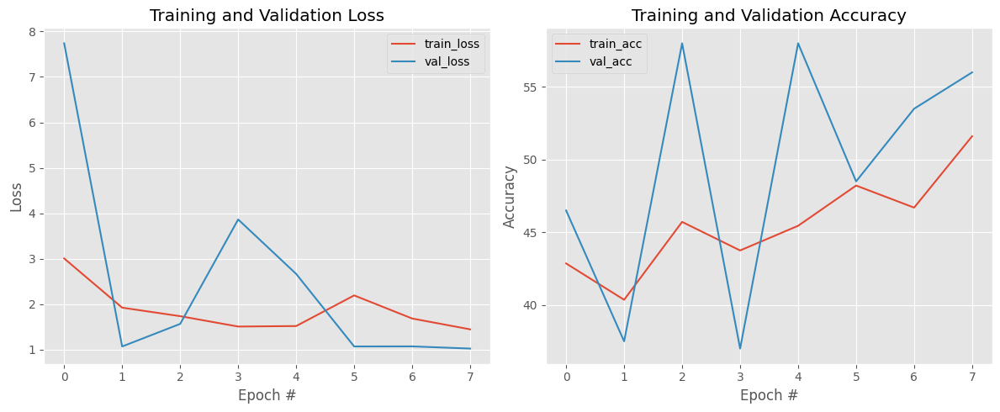

58.0

In [140]:
batch_size = 32

seed = 42
set_random_seed(seed)

# Esto asegura que el orden de los batches sea el mismo en cada ejecución
g_train = torch.Generator()
g_train.manual_seed(seed)

g_val = torch.Generator()
g_val.manual_seed(seed)

g_test = torch.Generator()
g_test.manual_seed(seed)

train_loader_mod1 = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
val_loader_mod1 = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
test_loader_mod1 = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

# Definimos parametros
input_size = train_df.drop(columns=['engagement_scores', 'main_image_path']).shape[1]  # Dimensiones de entrada (input_size), numero de Features
num_classes = 3 # Número de clases para engagement_scores, [0, 1, 2] Salida
freeze_layers = 7  # Cantidad de capas  a congelar
dropout_rate = 0.3 # Proporción de neuronas se no se van a usar, para reducir el overfitting

# Instanciamos nuestro modelo
model = NetEngagementPOI(input_size=input_size,
                             num_classes=num_classes,
                             dropout_rate=dropout_rate,
                             freeze_layers=freeze_layers).to(device)

train_model(trial=None, model=model, train_loader=train_loader_mod1, val_loader=val_loader_mod1, test_loader=test_loader_mod1)

Podemos observar:

*   La perdida en validación cae, oscila bastante, esto nos dice que es inestable y termina abajo de la de entrenamiento (la que va decreciendo constantemente)
*   Nuestro acc de entrenamiento va hacia la alza con algunas oscilaciones, mientras que en entrenamiento tiene varias oscilaciones (muy volatil) y termina subiendo arriba de la de entrenamiento.
*   El último valor Val Acc: 56.00%, esta por arriba de lo que adivinariamos al azar (33.33%)
*   El mejor accuracy de validación es: 58.00%
*   El tomo 155.38 segundos.



Dimensión de salida de images_cnn: 2048

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
Epoch 1/10, Train Loss: 2.9789, Train Acc: 39.20%, Val Loss: 2.1115, Val Acc: 51.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-27-02.pth' con Val Acc: 51.0000
Epoch 2/10, Train Loss: 2.1403, Train Acc: 43.04%, Val Loss: 1.4187, Val Acc: 45.00%
Epoch 3/10, Train Loss: 1.9010, Train Acc: 37.59%, Val Loss: 1.4596, Val Acc: 49.00%
Epoch 4/10, Train Loss: 1.5286, Train Acc: 41.61%, Val Loss: 1.1864, Val Acc: 45.50%
Epoch 5/10, Train Loss: 1.5853, Train Acc: 44.91%, Val Loss: 1.3416, Val Acc: 45.50%
Epoch 6/10, Train Loss: 1.5333, Train Acc: 41.70%, Val Loss: 1.0955, Val Acc: 53.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10

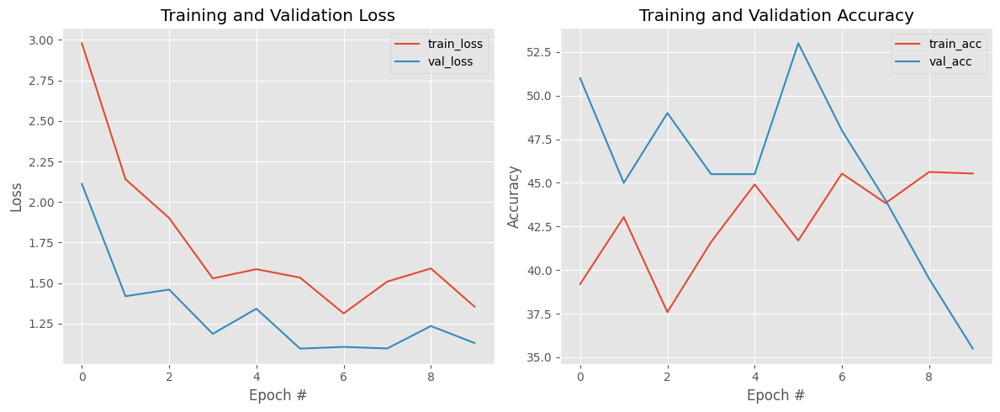

53.0

In [141]:
# Ahora probemos nuestro modelo más profundo
batch_size = 32
seed = 42
set_random_seed(seed)

# Esto asegura que el orden de los batches sea el mismo en cada ejecución
g_train = torch.Generator()
g_train.manual_seed(seed)

g_val = torch.Generator()
g_val.manual_seed(seed)

g_test = torch.Generator()
g_test.manual_seed(seed)

train_loader_mod2 = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
val_loader_mod2 = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
test_loader_mod2 = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

# Instanciamos nuestro modelo
model = NetEngagementPOIProfunda(input_size=input_size,
                             num_classes=num_classes,
                             dropout_rate=dropout_rate,
                             freeze_layers=freeze_layers).to(device)

train_model(trial=None, model=model, train_loader=train_loader_mod2, val_loader=val_loader_mod2, test_loader=test_loader_mod2)

Podemos observar:

*   La perdida en entrenamiento cae consistentemente y la de validación también. Parece que el modelo esta  aprendiendo bien.
*   Nuestro acc de entrenamiento se va a la alza, mientras que en entrenamiento empiza alto y va bajando muchisimo.
*   Existe overfitting. Nuestro modelo no generaliza bien.
*   El último valor Val Acc: 35.50%, un poco arriba de que adivinaramos al azar (33.33%), mucho peor que la anterior.
*   El mejor accuracy de validación es: 53.00%, peor que el anterior.
*   Le tomo 251.94 segundos, mucho mayor que la anterior pero era de esperarse dado que la red es mas profunda.
*   Completo las épocas



Dimensión de salida de images_cnn: 2048

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
Epoch 1/10, Train Loss: 2.0144, Train Acc: 42.41%, Val Loss: 3.5889, Val Acc: 54.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-31-19.pth' con Val Acc: 54.0000
Epoch 2/10, Train Loss: 1.4499, Train Acc: 46.61%, Val Loss: 1.4834, Val Acc: 48.50%
Epoch 3/10, Train Loss: 1.3337, Train Acc: 47.14%, Val Loss: 0.9222, Val Acc: 61.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-31-19.pth' con Val Acc: 61.0000
Epoch 4/10, Train Loss: 1.4232, Train Acc: 50.62%, Val Loss: 1.6540, Val Acc: 52.50%
Epoch 5/10, Train Loss: 1.3646, Train Acc: 48.30%, Val Loss: 1.0550, Val Acc: 50.50%
Epoch 6/10, Train Loss: 1.2839, Train Acc: 53.39%, V

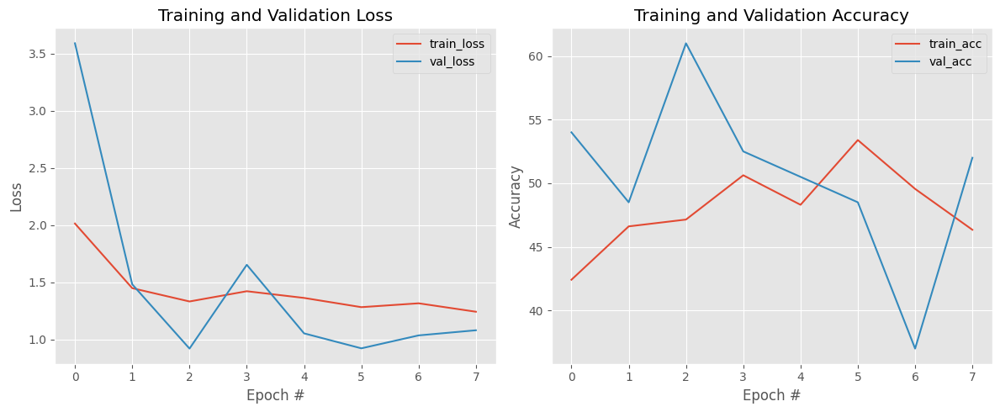

61.0

In [142]:
# Ahora probemos nuestro modelo mix
batch_size = 32
seed = 42
set_random_seed(seed)

# Esto asegura que el orden de los batches sea el mismo en cada ejecución
g_train = torch.Generator()
g_train.manual_seed(seed)

g_val = torch.Generator()
g_val.manual_seed(seed)

g_test = torch.Generator()
g_test.manual_seed(seed)

train_loader_mod3 = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
val_loader_mod3  = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
test_loader_mod3  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

# Instanciamos nuestro modelo
model = NetEngagementPOIMix(input_size=input_size,
                             num_classes=num_classes,
                             dropout_rate=dropout_rate,
                             freeze_layers=freeze_layers).to(device)

train_model(trial=None, model=model, train_loader=train_loader_mod3 , val_loader=val_loader_mod3 , test_loader=test_loader_mod3)

Podemos observar:

*   La perdida en entrenamiento cae consistente, y la de validación también con alguna oscilación pero termina en un valor mas bajo que la de entrenamiento.
*   Nuestro acc de entrenamiento parece que subia pero de repente comenzo a bajar, mientras que en validación muestras obscilaciones importantes siendo inestable.
*   El último valor Val Acc: 52.00%, por encima del azar (33.33%), el mejor que el anterior pero no que la primera red.
*   El mejor accuracy de validación es: 61.00%, mejor que los anteriores.
*   Le tomo 196.16 segundos.
*   No completo las épocas

Basandonos en los resultados anteriores, sobre todo en la mejor precisión de validación alcanzada antes del overfitting sería la primera red "NetEngagementPOI".

Voy a intentar modificar la primera para ver si mejora:

*   Quitar capas en el clasificador final
*   En la red para features vamos a hacer la ultima más estrecha.



In [143]:
class NetEngagementPOIFinal(nn.Module):
    def __init__(self, input_size=22, num_classes=3, dropout_rate=0.4, freeze_layers=5):

        super(NetEngagementPOIFinal, self).__init__()

        # Para nuestra features trabajaremos con capas full connected
        self.features_fc = nn.Sequential(

          # Primera Capa full connected
          # BatchNorm1d nos ayuda normalizar la salida de la capa antrior y acelerar el entrenamiento.
          # Función de activación Relu dado que para en general funicona muy bien para clasificación.
          # Ayuda con el problema del gradiente que tiende a desaparecer
          # Dropout para reducir el sobreajuste (overfitting). Nos ayuda a generalizar.
          nn.Linear(input_size, 64),
          nn.BatchNorm1d(64),
          nn.ReLU(),
          nn.Dropout(dropout_rate),

          # Segunda Capa full connected
          nn.Linear(64, 32),
          nn.BatchNorm1d(32),
          nn.ReLU(),
          nn.Dropout(dropout_rate),

          # Tercera Capa full connected
          nn.Linear(32, 16),
          nn.BatchNorm1d(16),
          nn.ReLU(),
          nn.Dropout(dropout_rate)

        )

        # Para nuestra imágenes como no tiene buena calidad ni tenemos muchos datos, vamos a provechar la arquitectura de ResNet-18
        # Cagamos el modelo pre-entrenado
        resnet18 = torchvision.models.resnet18(weights=models.ResNet18_Weights.DEFAULT)

        # Necesitamos congelar capas (Transfer Learning)
        # freeze_layers = cuántas capas iniciales se van a congelar para así tengamos una
        # red mas robusta dado que protege las lo aprendido en las capas congeladas.
        for param in list(resnet18.parameters())[:freeze_layers]:
            param.requires_grad = False # No queremos que actualice los pesos de estas capas (congelarlas)

        # Para nuestra imagenes trabajaremos con CNN
        self.images_cnn = nn.Sequential(
            # Tenemos que eliminar la última capa, que es el clasificador para ResNet que nosotros no vamos a usar
            *list(resnet18.children())[:-1],
            # Aplanamos la salida para poder combinarla.
            nn.Flatten()
        )

        # Obtener el tamaño de salida de la CNN después de Flatten.
        with torch.no_grad(): # No calcular gradientes porque solo vamos a comprabar el la salida de CNN
            ejem_image_input = torch.randn(1, 3, 224, 224)
            cnn_output_dim = self.images_cnn(ejem_image_input).shape[1]
            print(f"Dimensión de salida de images_cnn: {cnn_output_dim}")

        # Red final combinando la de features y la de imagenes y con el clasificador final
        # La salida de features_fc = 16.
        # La salida de images_cnn = 512 deberia de ser porque es lo que saca ResNet18.
        final_input_size = 16 + cnn_output_dim

        self.engagement_classifier = nn.Sequential(
            nn.Linear(final_input_size, 64),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Dropout(dropout_rate),

            nn.Linear(64, num_classes) # Capa de salida para 3 clases
        )

        #Inicialización de pesos y bias
        self.apply(self._initialize_weights_kaiming)

    #Función para inicializar los peos y bias en nuestras capas full connected
    def _initialize_weights_kaiming(self, m):
        if isinstance(m, nn.Linear):
          # Utilizamos a Kaiming normal porque va muy bien con la función de activación Relu.
          # Logra tener un entrenamiento más rapido dado que previene los probelmas del gradiente que desaparece.
            nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            # Y si tiene bias los inicialemos con cero para que no se introduzca un sesgo en las activaciones.
            if m.bias is not None:
                nn.init.constant_(m.bias, 0)

    def forward(self, features, images):

        # Pasar las features por la red fc
        features_output = self.features_fc(features)

        # Pasar las imágenes por la CNN
        images_output = self.images_cnn(images)

        # Concatenar las salidas de ambas redes
        # Dim=1 para poder mantener la dimensión del batch.
        output = torch.cat((features_output, images_output), dim=1)

        # Pasar la salida combinada por el clasificador final
        final_output = self.engagement_classifier(output)

        return final_output



Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
Epoch 1/10, Train Loss: 2.3364, Train Acc: 48.57%, Val Loss: 3.7813, Val Acc: 54.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-35-00.pth' con Val Acc: 54.0000
Epoch 2/10, Train Loss: 1.3767, Train Acc: 51.07%, Val Loss: 4.0380, Val Acc: 57.50%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-35-00.pth' con Val Acc: 57.5000
Epoch 3/10, Train Loss: 0.9763, Train Acc: 54.11%, Val Loss: 1.0336, Val Acc: 63.00%
  --> Mejor modelo guardado en 'best_models/best_model_2025-06-23_10-35-00.pth' con Val Acc: 63.0000
Epoch 4/10, Train Loss: 0.9046, Train Acc: 59.02%, Val Loss: 0.8585, Val Acc: 59.00%
Epoch 5/10, Train Loss: 0.9298, Train

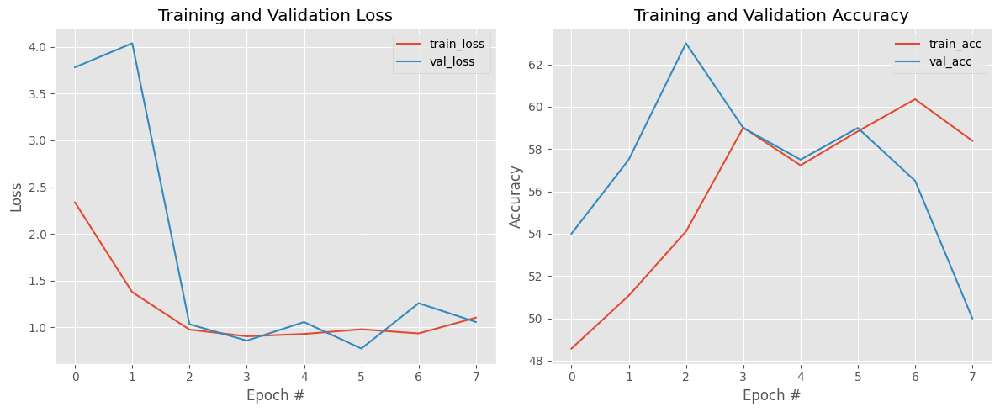

63.0

In [144]:
# Ahora probemos nuestro modelo mix
batch_size = 32
seed = 42
set_random_seed(seed)

# Esto asegura que el orden de los batches sea el mismo en cada ejecución
g_train = torch.Generator()
g_train.manual_seed(seed)

g_val = torch.Generator()
g_val.manual_seed(seed)

g_test = torch.Generator()
g_test.manual_seed(seed)

train_loader_modF = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
val_loader_modF = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
test_loader_modF = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

# Instanciamos nuestro modelo
model = NetEngagementPOIFinal(input_size=input_size,
                             num_classes=num_classes,
                             dropout_rate=dropout_rate,
                             freeze_layers=freeze_layers).to(device)

train_model(trial=None, model=model, train_loader=train_loader_modF, val_loader=val_loader_modF, test_loader=test_loader_modF)

Podemos observar:

*   Podemos observar que la perdida en entrenamiento disminuye de manera constante.
*   La perdida en validación empieza alta, pero rápido cae y termina mas abajo que la de entrenamiento. Tiene algunas oscilaciones pero en general la tendencia es a la baja.
*   La precisión en entramiento muestra una tendencia creciente y medio estable mientras que la de validación alcanza un punto muy alto y luego tiende a bajar.
*   El último valor Val Acc: 50.00%, el mejor de todos.
*   El mejor accuracy de validación es: 63.00%, el mejor de todos.
*   Le tomo 140.75 segundos, es más rápido que todos


Nos quedamos con este modelo porque:
- Tiene el mejor rendimiento de todas.
- Es la más rápida.
- La perdida en validación tiene tendencia a la baja.



In [146]:

# Imprimir tamaños de los datasets
print(f"Tamaño del conjunto de entrenamiento: {len(train_dataset)}")
print(f"Tamaño del conjunto de validación: {len(val_dataset)}")
print(f"Tamaño del conjunto de test: {len(test_dataset)}")

Tamaño del conjunto de entrenamiento: 1133
Tamaño del conjunto de validación: 200
Tamaño del conjunto de test: 236


In [147]:
print("Batches:")
print(f"Train: {len(train_loader)}")
print(f"Validation: {len(val_loader)}")
print(f"Test: {len(test_loader)}")

Batches:
Train: 35
Validation: 7
Test: 8


In [148]:
# Veamos nuestro modelo

model = NetEngagementPOIFinal()
model.to(device)
print(model)

Dimensión de salida de images_cnn: 512
NetEngagementPOIFinal(
  (features_fc): Sequential(
    (0): Linear(in_features=22, out_features=64, bias=True)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.4, inplace=False)
    (4): Linear(in_features=64, out_features=32, bias=True)
    (5): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Dropout(p=0.4, inplace=False)
    (8): Linear(in_features=32, out_features=16, bias=True)
    (9): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): Dropout(p=0.4, inplace=False)
  )
  (images_cnn): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilat

Salida del modelo para el primer elemento del batch: [-6.1693134   4.227091    0.73204565]
Target verdadero para el primer elemento del batch: 1
Pérdida calculada para el batch: 6.817826271057129
Gráfico del modelo generado como model_graph.png


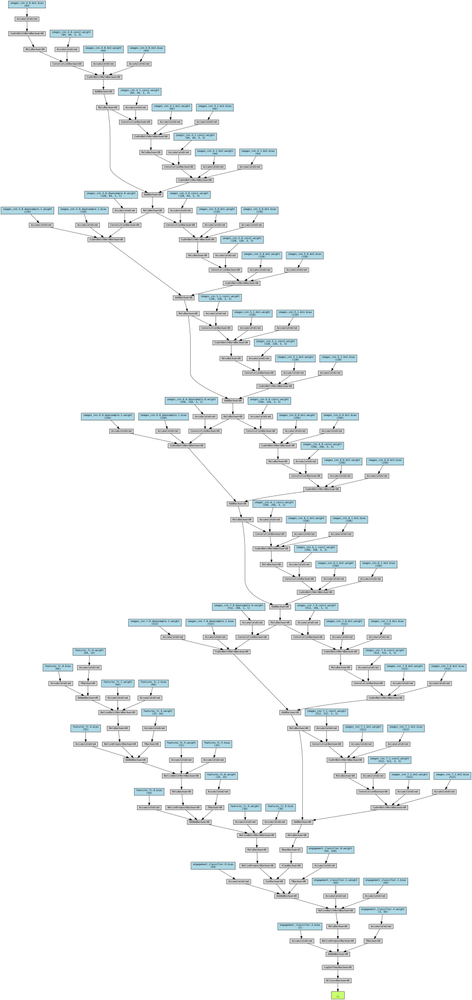

In [149]:
batch_size = 2

class DummyDataset(Dataset):
    def __len__(self):
        return 100 # Número de muestras dummy

    def __getitem__(self, idx):
        features = torch.randn(22)
        image = torch.randn(3, 224, 224)
        target = torch.randint(0, 3, (1,)).squeeze(0) # Etiquetas 0, 1, 2
        target = torch.LongTensor(target)
        return features, image, target

dummy_train_dataset = DummyDataset()
dummy_train_loader = DataLoader(dummy_train_dataset, batch_size=batch_size, shuffle=True)

features_batch, images_batch, target_batch = next(iter(dummy_train_loader))

features_batch = features_batch.to(device)
images_batch = images_batch.to(device)
target_batch = target_batch.to(device)

model.train()
criterion = nn.CrossEntropyLoss()
outputs = model(features_batch, images_batch)
loss = nn.CrossEntropyLoss()(outputs, target_batch)

dot = make_dot(loss, params=dict(model.named_parameters()), show_attrs=False, show_saved=False)

print(f"Salida del modelo para el primer elemento del batch: {outputs[0].detach().cpu().numpy()}")
print(f"Target verdadero para el primer elemento del batch: {target_batch[0].detach().cpu().numpy()}")
print(f"Pérdida calculada para el batch: {loss.item()}")
print("Gráfico del modelo generado como model_graph.png")

dot.render("model_graph_final", format="png", cleanup=True) # cleanup=True elimina los archivos intermedios

dot

Vamos a Optimizar los hiper-parametros con Optuna. Necesito modificar mis funciones de train.

In [150]:
def objective(trial):
    """
    Función objetivo para la optimización de hiperparámetros con Optuna.
    """
    print("\n" + "="*80)
    print(f"Iniciando Trial #{trial.number:03d}")
    print("="*80)

    # Definimos los rangos de parámetros a explorar
    dropout_rate = trial.suggest_categorical('dropout_rate', [0.1, 0.2, 0.3, 0.4, 0.5])
    freeze_layers = trial.suggest_categorical('freeze_layers', [5, 6, 7, 8, 9])


    # Usando producto cartesiano para generar todas las combinaciones
    #configurations = list(product(dropout_rates, learning_rates))

    print("\nHiperparámetros seleccionados:")
    print(f"   - Dropout Rate: {dropout_rate:.3f}")
    print(f"   - Freeze Layers: {freeze_layers:.2f}")

    batch_size=32

    seed = 42
    set_random_seed(seed)

    # Esto asegura que el orden de los batches sea el mismo en cada ejecución
    g_train = torch.Generator()
    g_train.manual_seed(seed)

    g_val = torch.Generator()
    g_val.manual_seed(seed)

    g_test = torch.Generator()
    g_test.manual_seed(seed)

    train_loader_Final = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
    val_loader_Final  = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
    test_loader_Final  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

    # Definimos parametros
    input_size = train_df.drop(columns=['engagement_scores', 'main_image_path']).shape[1]  # Dimensiones de entrada (input_size), numero de Features
    num_classes = 3 # Número de clases para engagement_scores, [0, 1, 2] Salida
    #freeze_layers = 7  # Cantidad de capas  a congelar
    #dropout_rate = 0.3 # Proporción de neuronas se no se van a usar, para reducir el overfitting

    # Instanciamos nuestro modelo
    model = NetEngagementPOIFinal(input_size=input_size,
                                  num_classes=num_classes,
                                  dropout_rate=dropout_rate,
                                  freeze_layers=freeze_layers).to(device)

    try:
        return train_model(trial, model, train_loader_Final, val_loader_Final, test_loader_Final)
    except Exception as e:
        print(f"❌ Trial failed with error: {str(e)}")
        raise optuna.exceptions.TrialPruned()

In [151]:
# Crear el estudio de Optuna con almacenamiento SQL
storage_url = "sqlite:///engagement_study.sqlite3"
study_name = "engagement_optimization"

try:
  # Eliminar estudio si existe
  optuna.delete_study(study_name=study_name, storage=storage_url)
except:
  pass

search_space = {
    "dropout_rate": [0.1, 0.2, 0.3, 0.4, 0.5],
    "freeze_layers": [5, 6, 7, 8, 9]
}

# Crear nuevo estudio
study = optuna.create_study(direction="maximize",
                            sampler=optuna.samplers.TPESampler(),
                            storage=storage_url,
                            study_name=study_name)

# Optimizar el modelo
study.optimize(objective, n_trials=50)
#Como cada trial duara aprox. 2 minutos para 50 trial, seran 100 minutos

[I 2025-06-23 10:40:44,469] A new study created in RDB with name: engagement_optimization



Iniciando Trial #000

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_0_2025-06-23_10-40-44.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_0_2025-06-23_10-40-44.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_0_2025-06-23_10-40-44.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_0_2025-06-23_10-40-44.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 10:43:22,102] Trial 0 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #001

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_10-43-22.pth' con Val Acc: 43.5000
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_10-43-22.pth' con Val Acc: 48.5000
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_10-43-22.pth' con Val Acc: 55.0000
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_10-43-22.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_10-43-22

[I 2025-06-23 10:45:56,019] Trial 1 finished with value: 62.0 and parameters: {'dropout_rate': 0.5, 'freeze_layers': 6}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 7.7952
Test Accuracy: 58.47%
Correct Predictions: 138/236

Iniciando Trial #002

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_10-45-56.pth' con Val Acc: 41.5000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_10-45-56.pth' con Val Acc: 53.0000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_10-45-56.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_10-45-56.pth' con Val Acc: 60.5000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_10-45-56

[I 2025-06-23 10:48:39,224] Trial 2 finished with value: 63.5 and parameters: {'dropout_rate': 0.3, 'freeze_layers': 8}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 0.7270
Test Accuracy: 66.10%
Correct Predictions: 156/236

Iniciando Trial #003

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_10-48-39.pth' con Val Acc: 43.5000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_10-48-39.pth' con Val Acc: 48.5000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_10-48-39.pth' con Val Acc: 55.0000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_10-48-39.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_10-48-39

[I 2025-06-23 10:51:16,966] Trial 3 finished with value: 62.0 and parameters: {'dropout_rate': 0.5, 'freeze_layers': 6}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 7.7952
Test Accuracy: 58.47%
Correct Predictions: 138/236

Iniciando Trial #004

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_10-51-17.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_10-51-17.pth' con Val Acc: 59.0000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_10-51-17.pth' con Val Acc: 59.5000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_10-51-17.pth' con Val Acc: 63.0000
El mejor accuracy de validación es: 63.00%


[I 2025-06-23 10:53:49,269] Trial 4 finished with value: 63.0 and parameters: {'dropout_rate': 0.4, 'freeze_layers': 8}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.3968
Test Accuracy: 44.49%
Correct Predictions: 105/236

Iniciando Trial #005

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 5.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_5_2025-06-23_10-53-49.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_5_2025-06-23_10-53-49.pth' con Val Acc: 60.5000
  --> Mejor modelo guardado en 'best_models/best_model_5_2025-06-23_10-53-49.pth' con Val Acc: 63.5000
El mejor accuracy de validación es: 63.50%


[I 2025-06-23 10:56:22,318] Trial 5 finished with value: 63.5 and parameters: {'dropout_rate': 0.3, 'freeze_layers': 5}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 4.0576
Test Accuracy: 51.27%
Correct Predictions: 121/236

Iniciando Trial #006

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 9.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_6_2025-06-23_10-56-22.pth' con Val Acc: 64.0000
  ¡Pérdida de validación no mejoró por 5 épocas consecutivas.
El mejor accuracy de validación es: 64.00%


[I 2025-06-23 10:57:53,076] Trial 6 finished with value: 64.0 and parameters: {'dropout_rate': 0.4, 'freeze_layers': 9}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.0625
Test Accuracy: 51.27%
Correct Predictions: 121/236

Iniciando Trial #007

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 10:58:08,228] Trial 7 pruned. 


❌ Trial failed with error: 

Iniciando Trial #008

Hiperparámetros seleccionados:
   - Dropout Rate: 0.200
   - Freeze Layers: 5.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_8_2025-06-23_10-58-08.pth' con Val Acc: 61.0000
  --> Mejor modelo guardado en 'best_models/best_model_8_2025-06-23_10-58-08.pth' con Val Acc: 61.5000


[I 2025-06-23 10:59:54,141] Trial 8 pruned. 


❌ Trial failed with error: 

Iniciando Trial #009

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:00:09,253] Trial 9 pruned. 


❌ Trial failed with error: 

Iniciando Trial #010

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_10_2025-06-23_11-00-09.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_10_2025-06-23_11-00-09.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_10_2025-06-23_11-00-09.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_10_2025-06-23_11-00-09.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:02:40,856] Trial 10 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #011

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_11-02-41.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_11-02-41.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_11-02-41.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_11-02-41.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:05:11,940] Trial 11 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #012

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_11-05-12.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_11-05-12.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_11-05-12.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_11-05-12.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:07:44,071] Trial 12 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #013

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_11-07-44.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_11-07-44.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_11-07-44.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_11-07-44.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:10:16,644] Trial 13 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #014

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_11-10-16.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_11-10-16.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_11-10-16.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_11-10-16.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:12:48,496] Trial 14 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #015

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 9.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:13:03,567] Trial 15 pruned. 


❌ Trial failed with error: 

Iniciando Trial #016

Hiperparámetros seleccionados:
   - Dropout Rate: 0.200
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_16_2025-06-23_11-13-03.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_16_2025-06-23_11-13-03.pth' con Val Acc: 62.5000


[I 2025-06-23 11:14:33,635] Trial 16 pruned. 


❌ Trial failed with error: 

Iniciando Trial #017

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_11-14-33.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_11-14-33.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_11-14-33.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_11-14-33.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:17:05,862] Trial 17 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #018

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_11-17-06.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_11-17-06.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_11-17-06.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_11-17-06.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:19:36,539] Trial 18 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #019

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 5.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:19:52,007] Trial 19 pruned. 


❌ Trial failed with error: 

Iniciando Trial #020

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:20:07,474] Trial 20 pruned. 


❌ Trial failed with error: 

Iniciando Trial #021

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_11-20-07.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_11-20-07.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_11-20-07.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_11-20-07.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:22:38,022] Trial 21 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #022

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_11-22-38.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_11-22-38.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_11-22-38.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_11-22-38.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:25:08,561] Trial 22 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #023

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_11-25-08.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_11-25-08.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_11-25-08.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_11-25-08.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:27:40,266] Trial 23 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #024

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_11-27-40.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_11-27-40.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_11-27-40.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_11-27-40.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:30:10,080] Trial 24 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #025

Hiperparámetros seleccionados:
   - Dropout Rate: 0.200
   - Freeze Layers: 9.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_11-30-10.pth' con Val Acc: 58.0000


[I 2025-06-23 11:30:54,709] Trial 25 pruned. 


❌ Trial failed with error: 

Iniciando Trial #026

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_11-30-55.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_11-30-55.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_11-30-55.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_11-30-55.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:33:25,226] Trial 26 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #027

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_11-33-25.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_11-33-25.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_11-33-25.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_11-33-25.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:35:56,178] Trial 27 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #028

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_28_2025-06-23_11-35-56.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_28_2025-06-23_11-35-56.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_28_2025-06-23_11-35-56.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_28_2025-06-23_11-35-56.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:38:27,925] Trial 28 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #029

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:38:43,266] Trial 29 pruned. 


❌ Trial failed with error: 

Iniciando Trial #030

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:38:58,247] Trial 30 pruned. 


❌ Trial failed with error: 

Iniciando Trial #031

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_11-38-58.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_11-38-58.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_11-38-58.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_11-38-58.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:41:28,785] Trial 31 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #032

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_11-41-29.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_11-41-29.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_11-41-29.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_11-41-29.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:44:00,606] Trial 32 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #033

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_11-44-00.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_11-44-00.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_11-44-00.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_11-44-00.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:46:34,706] Trial 33 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #034

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:46:50,464] Trial 34 pruned. 


❌ Trial failed with error: 

Iniciando Trial #035

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_35_2025-06-23_11-46-50.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_35_2025-06-23_11-46-50.pth' con Val Acc: 59.0000


[I 2025-06-23 11:47:37,269] Trial 35 pruned. 


❌ Trial failed with error: 

Iniciando Trial #036

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 5.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:47:52,938] Trial 36 pruned. 


❌ Trial failed with error: 

Iniciando Trial #037

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 9.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:48:08,613] Trial 37 pruned. 


❌ Trial failed with error: 

Iniciando Trial #038

Hiperparámetros seleccionados:
   - Dropout Rate: 0.200
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_38_2025-06-23_11-48-08.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_38_2025-06-23_11-48-08.pth' con Val Acc: 62.5000


[I 2025-06-23 11:48:55,089] Trial 38 pruned. 


❌ Trial failed with error: 

Iniciando Trial #039

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:49:10,616] Trial 39 pruned. 


❌ Trial failed with error: 

Iniciando Trial #040

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 8.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:49:26,015] Trial 40 pruned. 


❌ Trial failed with error: 

Iniciando Trial #041

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_11-49-26.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_11-49-26.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_11-49-26.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_11-49-26.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:51:58,663] Trial 41 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #042

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_11-51-58.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_11-51-58.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_11-51-58.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_11-51-58.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:54:29,594] Trial 42 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #043

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_11-54-30.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_11-54-30.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_11-54-30.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_11-54-30.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 11:57:01,538] Trial 43 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #044

Hiperparámetros seleccionados:
   - Dropout Rate: 0.300
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:57:17,076] Trial 44 pruned. 


❌ Trial failed with error: 

Iniciando Trial #045

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 5.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 11:57:33,135] Trial 45 pruned. 


❌ Trial failed with error: 

Iniciando Trial #046

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_11-57-33.pth' con Val Acc: 58.0000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_11-57-33.pth' con Val Acc: 65.5000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_11-57-33.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_11-57-33.pth' con Val Acc: 70.0000
El mejor accuracy de validación es: 70.00%


[I 2025-06-23 12:00:08,798] Trial 46 finished with value: 70.0 and parameters: {'dropout_rate': 0.1, 'freeze_layers': 7}. Best is trial 0 with value: 70.0.



Test Set Metrics:
Test Loss: 1.7367
Test Accuracy: 63.98%
Correct Predictions: 151/236

Iniciando Trial #047

Hiperparámetros seleccionados:
   - Dropout Rate: 0.400
   - Freeze Layers: 9.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_47_2025-06-23_12-00-09.pth' con Val Acc: 64.0000


[I 2025-06-23 12:00:57,859] Trial 47 pruned. 


❌ Trial failed with error: 

Iniciando Trial #048

Hiperparámetros seleccionados:
   - Dropout Rate: 0.500
   - Freeze Layers: 6.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar


[I 2025-06-23 12:01:15,328] Trial 48 pruned. 


❌ Trial failed with error: 

Iniciando Trial #049

Hiperparámetros seleccionados:
   - Dropout Rate: 0.200
   - Freeze Layers: 7.00
Dimensión de salida de images_cnn: 512

Parámetros seleccionados:
   - Batch Size: 32
   - Tamaño de Features: 22
   - Clases engagement: 3
   - Numero de Freeze Layers: 7
   - Dropout Rate: 0.300
   - Learning Rate: 0.001000
   - Epocas: 10
   - Early Stopping cada: 5
   - Regularización L2: 0.000100
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_12-01-15.pth' con Val Acc: 58.5000
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_12-01-15.pth' con Val Acc: 62.5000


[I 2025-06-23 12:02:04,141] Trial 49 pruned. 


❌ Trial failed with error: 


Observemos el mejor trial que nos dio Optu



In [155]:
def show_trial_details(study, trial_number):
    """
    Muestra información detallada de un trial específico.

    Args:
        study: Estudio de Optuna
        trial_number: Número del trial a mostrar
    """
    trial = study.trials[trial_number]

    print(f"\nTrial #{trial.number}")
    print(f"Valor: {trial.value}")
    print("Parámetros:")
    for param, value in trial.params.items():
        print(f"  {param}: {value}")
    print("Atributos de usuario:")
    for attr, value in trial.user_attrs.items():
        print(f"  {attr}: {value}")
    print(f"Estado: {trial.state}")
    print(f"Fecha inicio: {trial.datetime_start}")
    print(f"Fecha fin: {trial.datetime_complete}")

# Ejemplo de uso:
show_trial_details(study, 1)  # Muestra detalles del primer trial


Trial #1
Valor: 62.0
Parámetros:
  dropout_rate: 0.5
  freeze_layers: 6
Atributos de usuario:
  correct_predictions: 138
  test_accuracy: 58.47457627118644
  test_loss: 7.7951924726367
  total_samples: 236
Estado: 1
Fecha inicio: 2025-06-23 10:43:22.109472
Fecha fin: 2025-06-23 10:45:56.001329


In [154]:
study = optuna.load_study(
    study_name = "engagement_optimization",
    storage = "sqlite:///engagement_study.sqlite3"
)

print(f"Estudio cargado con {len(study.trials)} trials completados")

# Mostrar las mejores trials
print("\nMejores trials:")
print("Número de trial\tValor")
# Filter out trials with None values before sorting
completed_trials = [t for t in study.trials if t.value is not None]
best_trials = sorted(completed_trials, key=lambda t: t.value, reverse=True)[:5]
for trial in best_trials:
    print(f"#{trial.number}\t\t{trial.value:.4f}")



Estudio cargado con 50 trials completados

Mejores trials:
Número de trial	Valor
#0		70.0000
#10		70.0000
#11		70.0000
#12		70.0000
#13		70.0000


In [156]:
# Gráfico de optimización
optuna.visualization.plot_optimization_history(study)


El proceso de optimización ha convergido muy rápidamente.

Optuna encontró un valor de 70 (o muy cercano) casi de inmediato  y no ha logrado superarlo en los trials posteriores.



In [157]:
# Gráfico de importancia de parámetros
optuna.visualization.plot_param_importances(study)


Podemos observar que ambos parametros tienen la misma importancia.

Ambas tienen un impacto significativo y casi idéntico en el rendimiento del modelo.


In [158]:
# Gráfico de valores paralelos
optuna.visualization.plot_parallel_coordinate(study)

In [159]:
# Gráfico de slice
optuna.visualization.plot_slice(study)

Para el espacio de búsqueda que definimos, las mejores combinaciones de hiperparámetros son:

*   dropout_rate aprox.  0.1
*   freeze_layers igual a 7





Podriamos volver a ejecutar Optuna modificando el rango dropout_rate con valores alrededor de 0.1, el de freeze_layers no lo incluiremos porque el resultado obtenido esta justo en el centro del rango que abarcamos.

Tambien vamos a incrementar un poco el número de epocas a 15, no es un gran cambio porque en validación nuestra precisión tenía tendencia a ir a la baja.

Y el batch_size a 16 para ayudar a nuestra GPU, ver si nos ayuda a generalizar mejor.



In [216]:
# Empecemos por definir nuestra función de entrenamiento

def train_model2(trial, model, train_loader, val_loader, test_loader):

    learning_rate = 0.001
    num_epochs = 15   # lo subimos un poco
    weight_decay = 1e-4
    patience = 5

    model_path = f'best_models'
    os.makedirs(model_path, exist_ok=True)

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(),
                           lr=learning_rate,
                           weight_decay=weight_decay)

    patience_scheduler = 3
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                           mode='min',
                                                           factor=0.5,
                                                           patience=patience_scheduler)

    print("Vamos a entrenar")
    start_time = time.time()
    best_val_acc, train_accs, val_accs, train_losses, val_losses, completed_epochs= train_epoch(trial=trial,
                                                                                                model=model,
                                                                                                train_loader=train_loader,
                                                                                                val_loader=val_loader,
                                                                                                criterion=criterion,
                                                                                                optimizer=optimizer,
                                                                                                num_epochs=num_epochs,
                                                                                                patience=patience,
                                                                                                scheduler=scheduler,
                                                                                                model_path=model_path)

    end_time = time.time()

    if trial is None:
      print(f"\nTiempo de entrenamiento: {end_time - start_time:.2f} segundos")

      plot_training_curves(train_losses, val_losses, train_accs, val_accs, completed_epochs)


    if trial is not None:
      test_metrics = evaluate_model(model, test_loader, criterion)
      print("\nTest Set Metrics:")
      print(f"Test Loss: {test_metrics['test_loss']:.4f}")
      print(f"Test Accuracy: {test_metrics['test_accuracy']:.2f}%")
      print(f"Correct Predictions: {test_metrics['correct_predictions']}/{test_metrics['total_samples']}")

      trial.set_user_attr('test_loss', float(test_metrics['test_loss']))
      trial.set_user_attr('test_accuracy', float(test_metrics['test_accuracy']))
      trial.set_user_attr('correct_predictions', int(test_metrics['correct_predictions']))
      trial.set_user_attr('total_samples', int(test_metrics['total_samples']))

    return best_val_acc


In [217]:
def objective2(trial):
    """
    Función objetivo para la optimización de hiperparámetros con Optuna.
    """
    print("\n" + "="*80)
    print(f"Iniciando Trial #{trial.number:03d}")
    print("="*80)

    # Definimos los rangos de parámetros a explorar
    dropout_rate = trial.suggest_categorical('dropout_rate', [0.05, 0.1, 0.15])

    # Usando producto cartesiano para generar todas las combinaciones
    #configurations = list(product(dropout_rates, learning_rates))

    print("\nHiperparámetros seleccionados:")
    print(f"   - Dropout Rate: {dropout_rate:.3f}")

    batch_size=16 # Bajamos a 16.

    seed = 42
    set_random_seed(seed)
    g_train = torch.Generator()
    g_train.manual_seed(seed)
    g_val = torch.Generator()
    g_val.manual_seed(seed)
    g_test = torch.Generator()
    g_test.manual_seed(seed)

    train_loader_Final = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, drop_last=True, generator=g_train, num_workers=0)
    val_loader_Final  = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, generator=g_val, num_workers=0)
    test_loader_Final  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, generator=g_test, num_workers=0)

    # Definimos parametros
    input_size = train_df.drop(columns=['engagement_scores', 'main_image_path']).shape[1]  # Dimensiones de entrada (input_size), numero de Features
    num_classes = 3 # Número de clases para engagement_scores, [0, 1, 2] Salida
    freeze_layers = 7  # Cantidad de capas  a congelar
    #dropout_rate = 0.3 # Proporción de neuronas se no se van a usar, para reducir el overfitting

    # Instanciamos nuestro modelo
    model = NetEngagementPOIFinal(input_size=input_size,
                                  num_classes=num_classes,
                                  dropout_rate=dropout_rate,
                                  freeze_layers=freeze_layers).to(device)

    try:
        return train_model2(trial, model, train_loader_Final, val_loader_Final, test_loader_Final)
    except Exception as e:
        print(f"❌ Trial failed with error: {str(e)}")
        raise optuna.exceptions.TrialPruned()

In [219]:
# Crear el estudio de Optuna con almacenamiento SQL
storage_url = "sqlite:///engagement_study2.sqlite3"
study_name = "engagement_optimization2"

try:
  # Eliminar estudio si existe
  optuna.delete_study(study_name=study_name, storage=storage_url)
except:
  pass

search_space = {
    "dropout_rate": [0.05, 0.1, 0.15]
}

# Crear nuevo estudio
study = optuna.create_study(direction="maximize",
                            sampler=optuna.samplers.TPESampler(),
                            storage=storage_url,
                            study_name=study_name)

# Optimizar el modelo
study.optimize(objective2, n_trials=50)
#Como cada trial duara aprox. 2 minutos para 50 trial, seran 100 minutos

[I 2025-06-23 16:55:36,079] A new study created in RDB with name: engagement_optimization2



Iniciando Trial #000

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_0_2025-06-23_16-55-36.pth' con Val Acc: 60.0000
  ¡Pérdida de validación no mejoró por 5 épocas consecutivas.
El mejor accuracy de validación es: 60.00%


[I 2025-06-23 16:57:24,719] Trial 0 finished with value: 60.0 and parameters: {'dropout_rate': 0.15}. Best is trial 0 with value: 60.0.



Test Set Metrics:
Test Loss: 1.1350
Test Accuracy: 58.05%
Correct Predictions: 137/236

Iniciando Trial #001

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_1_2025-06-23_16-57-25.pth' con Val Acc: 60.0000
  ¡Pérdida de validación no mejoró por 5 épocas consecutivas.
El mejor accuracy de validación es: 60.00%


[I 2025-06-23 16:59:12,806] Trial 1 finished with value: 60.0 and parameters: {'dropout_rate': 0.15}. Best is trial 0 with value: 60.0.



Test Set Metrics:
Test Loss: 1.1350
Test Accuracy: 58.05%
Correct Predictions: 137/236

Iniciando Trial #002

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_16-59-13.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_16-59-13.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_16-59-13.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_16-59-13.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_2_2025-06-23_16-59-13.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:03:42,520] Trial 2 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #003

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_17-03-42.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_17-03-42.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_17-03-42.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_17-03-42.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_3_2025-06-23_17-03-42.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:08:08,815] Trial 3 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #004

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_17-08-09.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_17-08-09.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_17-08-09.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_17-08-09.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_4_2025-06-23_17-08-09.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:12:33,859] Trial 4 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #005

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_5_2025-06-23_17-12-34.pth' con Val Acc: 60.0000


[I 2025-06-23 17:14:01,481] Trial 5 pruned. 


❌ Trial failed with error: 

Iniciando Trial #006

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_6_2025-06-23_17-14-01.pth' con Val Acc: 59.5000


[I 2025-06-23 17:15:29,391] Trial 6 pruned. 


❌ Trial failed with error: 

Iniciando Trial #007

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_7_2025-06-23_17-15-29.pth' con Val Acc: 60.0000


[I 2025-06-23 17:16:58,715] Trial 7 pruned. 


❌ Trial failed with error: 

Iniciando Trial #008

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_8_2025-06-23_17-16-59.pth' con Val Acc: 60.0000


[I 2025-06-23 17:18:32,070] Trial 8 pruned. 


❌ Trial failed with error: 

Iniciando Trial #009

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_9_2025-06-23_17-18-32.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_9_2025-06-23_17-18-32.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_9_2025-06-23_17-18-32.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_9_2025-06-23_17-18-32.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_9_2025-06-23_17-18-32.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:22:57,066] Trial 9 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #010

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_10_2025-06-23_17-22-57.pth' con Val Acc: 59.5000


[I 2025-06-23 17:24:25,059] Trial 10 pruned. 


❌ Trial failed with error: 

Iniciando Trial #011

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_17-24-25.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_17-24-25.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_17-24-25.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_17-24-25.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_11_2025-06-23_17-24-25.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:28:49,480] Trial 11 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #012

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_17-28-49.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_17-28-49.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_17-28-49.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_17-28-49.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_12_2025-06-23_17-28-49.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:33:14,950] Trial 12 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #013

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_17-33-15.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_17-33-15.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_17-33-15.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_17-33-15.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_13_2025-06-23_17-33-15.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:37:40,135] Trial 13 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #014

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_17-37-40.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_17-37-40.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_17-37-40.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_17-37-40.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_14_2025-06-23_17-37-40.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:42:05,142] Trial 14 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #015

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_15_2025-06-23_17-42-05.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_15_2025-06-23_17-42-05.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_15_2025-06-23_17-42-05.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_15_2025-06-23_17-42-05.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_15_2025-06-23_17-42-05.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:46:28,027] Trial 15 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #016

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_16_2025-06-23_17-46-28.pth' con Val Acc: 59.5000


[I 2025-06-23 17:47:54,592] Trial 16 pruned. 


❌ Trial failed with error: 

Iniciando Trial #017

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_17-47-55.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_17-47-55.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_17-47-55.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_17-47-55.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_17_2025-06-23_17-47-55.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:52:19,178] Trial 17 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #018

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_17-52-19.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_17-52-19.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_17-52-19.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_17-52-19.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_18_2025-06-23_17-52-19.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 17:56:45,835] Trial 18 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #019

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_19_2025-06-23_17-56-46.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_19_2025-06-23_17-56-46.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_19_2025-06-23_17-56-46.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_19_2025-06-23_17-56-46.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_19_2025-06-23_17-56-46.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:01:11,181] Trial 19 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #020

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_20_2025-06-23_18-01-11.pth' con Val Acc: 59.5000


[I 2025-06-23 18:02:37,256] Trial 20 pruned. 


❌ Trial failed with error: 

Iniciando Trial #021

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_18-02-37.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_18-02-37.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_18-02-37.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_18-02-37.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_21_2025-06-23_18-02-37.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:06:59,132] Trial 21 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #022

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_18-06-59.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_18-06-59.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_18-06-59.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_18-06-59.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_22_2025-06-23_18-06-59.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:11:23,562] Trial 22 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #023

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_18-11-23.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_18-11-23.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_18-11-23.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_18-11-23.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_23_2025-06-23_18-11-23.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:15:46,692] Trial 23 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #024

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_18-15-46.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_18-15-46.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_18-15-46.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_18-15-46.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_24_2025-06-23_18-15-46.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:20:08,345] Trial 24 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #025

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_18-20-08.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_18-20-08.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_18-20-08.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_18-20-08.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_25_2025-06-23_18-20-08.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:24:29,644] Trial 25 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #026

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_18-24-29.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_18-24-29.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_18-24-29.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_18-24-29.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_26_2025-06-23_18-24-29.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:28:52,936] Trial 26 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #027

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_18-28-53.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_18-28-53.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_18-28-53.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_18-28-53.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_27_2025-06-23_18-28-53.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:33:20,417] Trial 27 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #028

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_28_2025-06-23_18-33-20.pth' con Val Acc: 59.5000


[I 2025-06-23 18:34:49,233] Trial 28 pruned. 


❌ Trial failed with error: 

Iniciando Trial #029

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_29_2025-06-23_18-34-49.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_29_2025-06-23_18-34-49.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_29_2025-06-23_18-34-49.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_29_2025-06-23_18-34-49.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_29_2025-06-23_18-34-49.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:39:15,263] Trial 29 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #030

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_30_2025-06-23_18-39-15.pth' con Val Acc: 60.0000


[I 2025-06-23 18:40:43,920] Trial 30 pruned. 


❌ Trial failed with error: 

Iniciando Trial #031

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_18-40-44.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_18-40-44.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_18-40-44.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_18-40-44.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_31_2025-06-23_18-40-44.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:45:11,856] Trial 31 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #032

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_18-45-12.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_18-45-12.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_18-45-12.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_18-45-12.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_32_2025-06-23_18-45-12.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:49:40,215] Trial 32 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #033

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_18-49-40.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_18-49-40.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_18-49-40.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_18-49-40.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_33_2025-06-23_18-49-40.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:54:03,205] Trial 33 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #034

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_34_2025-06-23_18-54-03.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_34_2025-06-23_18-54-03.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_34_2025-06-23_18-54-03.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_34_2025-06-23_18-54-03.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_34_2025-06-23_18-54-03.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 18:58:26,518] Trial 34 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #035

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_35_2025-06-23_18-58-26.pth' con Val Acc: 60.0000


[I 2025-06-23 18:59:53,863] Trial 35 pruned. 


❌ Trial failed with error: 

Iniciando Trial #036

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_36_2025-06-23_18-59-54.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_36_2025-06-23_18-59-54.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_36_2025-06-23_18-59-54.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_36_2025-06-23_18-59-54.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_36_2025-06-23_18-59-54.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:04:17,162] Trial 36 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #037

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_37_2025-06-23_19-04-17.pth' con Val Acc: 60.0000


[I 2025-06-23 19:05:44,204] Trial 37 pruned. 


❌ Trial failed with error: 

Iniciando Trial #038

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_38_2025-06-23_19-05-44.pth' con Val Acc: 59.5000


[I 2025-06-23 19:07:10,810] Trial 38 pruned. 


❌ Trial failed with error: 

Iniciando Trial #039

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_39_2025-06-23_19-07-11.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_39_2025-06-23_19-07-11.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_39_2025-06-23_19-07-11.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_39_2025-06-23_19-07-11.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_39_2025-06-23_19-07-11.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:11:33,854] Trial 39 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #040

Hiperparámetros seleccionados:
   - Dropout Rate: 0.150
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_40_2025-06-23_19-11-34.pth' con Val Acc: 60.0000


[I 2025-06-23 19:13:01,309] Trial 40 pruned. 


❌ Trial failed with error: 

Iniciando Trial #041

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_19-13-01.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_19-13-01.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_19-13-01.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_19-13-01.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_41_2025-06-23_19-13-01.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:17:41,350] Trial 41 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #042

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_19-17-41.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_19-17-41.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_19-17-41.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_19-17-41.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_42_2025-06-23_19-17-41.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:22:19,032] Trial 42 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #043

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_19-22-19.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_19-22-19.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_19-22-19.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_19-22-19.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_43_2025-06-23_19-22-19.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:27:33,106] Trial 43 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #044

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_44_2025-06-23_19-27-33.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_44_2025-06-23_19-27-33.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_44_2025-06-23_19-27-33.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_44_2025-06-23_19-27-33.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_44_2025-06-23_19-27-33.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:32:40,523] Trial 44 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #045

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_45_2025-06-23_19-32-40.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_45_2025-06-23_19-32-40.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_45_2025-06-23_19-32-40.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_45_2025-06-23_19-32-40.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_45_2025-06-23_19-32-40.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:37:27,698] Trial 45 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #046

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_19-37-28.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_19-37-28.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_19-37-28.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_19-37-28.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_46_2025-06-23_19-37-28.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:42:21,022] Trial 46 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #047

Hiperparámetros seleccionados:
   - Dropout Rate: 0.050
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_47_2025-06-23_19-42-21.pth' con Val Acc: 59.5000


[I 2025-06-23 19:43:56,322] Trial 47 pruned. 


❌ Trial failed with error: 

Iniciando Trial #048

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_48_2025-06-23_19-43-57.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_48_2025-06-23_19-43-57.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_48_2025-06-23_19-43-57.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_48_2025-06-23_19-43-57.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_48_2025-06-23_19-43-57.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:48:52,421] Trial 48 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236

Iniciando Trial #049

Hiperparámetros seleccionados:
   - Dropout Rate: 0.100
Dimensión de salida de images_cnn: 512
Vamos a entrenar
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_19-48-52.pth' con Val Acc: 54.0000
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_19-48-52.pth' con Val Acc: 56.5000
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_19-48-52.pth' con Val Acc: 64.5000
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_19-48-52.pth' con Val Acc: 66.0000
  --> Mejor modelo guardado en 'best_models/best_model_49_2025-06-23_19-48-52.pth' con Val Acc: 66.5000
El mejor accuracy de validación es: 66.50%


[I 2025-06-23 19:53:31,736] Trial 49 finished with value: 66.5 and parameters: {'dropout_rate': 0.1}. Best is trial 2 with value: 66.5.



Test Set Metrics:
Test Loss: 0.8329
Test Accuracy: 70.34%
Correct Predictions: 166/236


In [221]:


# Mostrar las mejores trials
print("\nMejores trials:")
print("Número de trial\tValor")
# Filter out trials with None values before sorting
completed_trials = [t for t in study.trials if t.value is not None]
best_trials = sorted(completed_trials, key=lambda t: t.value, reverse=True)[:5]
for trial in best_trials:
    print(f"#{trial.number}\t\t{trial.value:.4f}")




Mejores trials:
Número de trial	Valor
#2		66.5000
#3		66.5000
#4		66.5000
#9		66.5000
#11		66.5000


In [222]:
# Gráfico de optimización
optuna.visualization.plot_optimization_history(study)


Basandonos en los resultados obtenidos en este segundo intento con Optuna, nos quedamos con el mejor modelo de la primera vez que ejecutamos la optimización de hiperparametros con Optuna.

# Evaluación

In [200]:
# El mejor trial con su los valores de los hiperparametros.
best_trial = study.best_trial
print(f"Mejor Accuracy: {best_trial.value}")
print("Mejores valores para los hiperparametros:", best_trial.params)

Mejor Accuracy: 70.0
Mejores valores para los hiperparametros: {'dropout_rate': 0.1, 'freeze_layers': 7}


In [176]:
# Cargar el mejor modelo con los hiperparámetros más óptimos
best_params = best_trial.params
model = NetEngagementPOIFinal(
    dropout_rate=best_params['dropout_rate'],
    freeze_layers=best_params['freeze_layers']
).to(device)

file_pattern = f'best_models/best_model_{best_trial.number}_*.pth'
found_files = glob.glob(file_pattern)

best_model_path = found_files[0]

# Cargar los pesos del mejor modelo
checkpoint = torch.load(best_model_path)
model.load_state_dict(checkpoint)
model.eval()

print("Parametros del mejor modelo:")
print(f"Dropout rate: {best_params['dropout_rate']}")
print(f"Freeze layers: {best_params['freeze_layers']}")

Dimensión de salida de images_cnn: 512
Best model loaded with parameters:
Dropout rate: 0.1
Freeze layers: 7


In [194]:
# Necesitamos primero evaluar nuestro modelo en el conjunto de datos de prueba
model.eval()
test_loss = 0
test_correct = 0
total = 0

#Extraemos las etiquetas del cojunto de entraneminto en un array
y_train = train_dataset.target.cpu().numpy()

# Necesitamos tener los pesos basandonos en el conjunto de entrenamiento
# Esto porque es lo que nuestro modelo aprendio, no se puede hacer en el de test dado que sería sobreajustar
class_weights = compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights = torch.FloatTensor(class_weights).to(device)

label_smoothing_value = best_params.get('label_smoothing', 0.0)

# Le pasamos a nuestra función de perdida los pesos del entrenamiento, junto con los mejores valores optenidos con optuna
# Esta es la misma función utilizada en el entrenamiento.
criterion = nn.CrossEntropyLoss(weight=class_weights, label_smoothing=label_smoothing_value)


with torch.no_grad():# No necesitamos calcular gradientes porque vamos a evaluar
    #Evaluamos el modelo con el conjunto de pruebas (test), con datos nunca antes vistos.
    for features, images, tragets in test_loader_Final:
        features, images, tragets = features.to(device), images.to(device), tragets.to(device)
        outputs = model(features, images)
        loss = criterion(outputs, tragets)

        test_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        total += tragets.size(0)
        test_correct += (predicted == tragets).sum().item()

test_loss = test_loss / len(test_loader_Final)
test_accuracy = 100 * test_correct / total

print(f'\nResultados en Test:')
print(f'Average Loss: {test_loss:.4f}')
print(f'Accuracy: {test_accuracy:.2f}%')
print(f'Prediciones correctas del total: {test_correct}/{total}')


Test Results:
Average Loss: 0.7087
Accuracy: 69.49%
Correct Predictions: 164/236


Podemos confirmar que la optimización con Optuna encontró los valores adecuados dado que con la precisión final de 69.49% (casi igual a la esperada) y nos indica que el modelo ha generalizado bien.

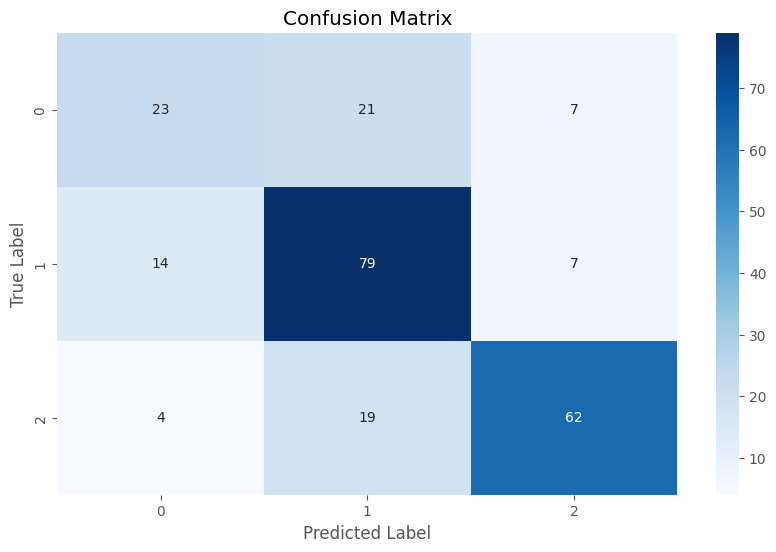


Classification Report:
              precision    recall  f1-score   support

        Bajo       0.56      0.45      0.50        51
       Medio       0.66      0.79      0.72       100
        Alto       0.82      0.73      0.77        85

    accuracy                           0.69       236
   macro avg       0.68      0.66      0.66       236
weighted avg       0.70      0.69      0.69       236



In [196]:
# Evaluación final
model.eval()
all_predictions = []
all_labels = []

with torch.no_grad():
    for features, images, targets in test_loader_Final:
        features, images, targets = features.to(device), images.to(device), targets.to(device)
        outputs = model(features, images)
        _, predicted = torch.max(outputs.data, 1)
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(targets.cpu().numpy())

# Matriz de confusión
cm = confusion_matrix(all_labels, all_predictions)
plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de confusión')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Reporte de clasificación
print("\nClassification Report:")
print(classification_report(all_labels, all_predictions,
                        target_names=['Bajo', 'Medio', 'Alto']))

# **Matriz de Confusión y Reporte de Clasificación**

Las filas representan las clases reales mientras que las columnas las predichas. Podemos observar el detalle de como se distribulen los aciertos y errores:

*   **23 registros que realmente eran 0 fueron predichos como 0**
*   21 registros que realmente eran 0 fueron predichos como 1
*   7 registros que realmente eran 0 fueron predichos como 2

  **Total de clase 0 reales = 51**


*   14 registros que realmente eran 1 fueron predichos como 0
*  **79 registros que realmente eran 1 fueron predichos como 1**
*   7 registros que realmente eran 1 fueron predichos como 2

  **Total de clase 1 reales = 100**


*  4 registros que realmente eran 2 fueron predichos como 0
*  19 registros que realmente eran 2 fueron predichos como 1
*  **62 registros que realmente eran 2 fueron predichos como 2**

  **Total de clase 2 reales = 85**


Observamos que tienen mejor rendimiento las clases 1 y 2:

*   **Clase 1 con un 79% de recall**, es decir que por cada 100 instancias de clase 1, 79 fueron encontradas correctamente.
*   **Clase 2 con un 73%** de recall, es decir que por cada 100 instancias de clase 2 73 fueron encontradas correctamente.
*   En cambio la **Clase 0 tuvo más problemas**, muestra un 45% en recall, dejando de identificar correctamente casi la mitad.

Esto también lo podemos confirmar con la precisión que confirma que la clase 0 es en la que más problemas tuvo (56% de probabilidades de estar en lo correcto). Aunque a la clase 1 también le da un valor más bajo que en el recall, con un 66% de estar en lo correcto.

Observando el f1-score, si es alto nos indica que el model tiene buena precisión y buen recall. Con esta métrica confirmamos que la clase 0 es quien presenta mayores problemas.


- **69% es la precisión general del modelo** en el conjunto de datos de test, es decir que el modelo acierta el 69% de las predicciones.


En general podemos decir que nuestro modelo tiene un rendimiento general aceptable. Siendo más eficaz para las clases 1 y 2.



# Extras

Visualización de nuestro modelo con Netron.

In [211]:
model.eval()

batch_size=32

device = (
    "cuda"
    if torch.cuda.is_available()
    else "cpu"
)

dummy_features = torch.randn(1, 22).to(device) # (batch_size, feature_size)
dummy_images = torch.randn(1, 3, 224, 224).to(device)

# Definimos el nombre delfichero de salida
onnx_model_path = "engagement_model.onnx"

try:
    torch.onnx.export(
        model,                            # Mi modelo
        (dummy_features, dummy_images),
        onnx_model_path,                  # Ruta de salida
        export_params=True,               # Exportar los pesos del modelo también
        opset_version=11,
        do_constant_folding=True,         # Optimización de ONNX
        input_names=['features_input', 'images_input'], # Nombres para tus entradas en Netron
        output_names=['output_logits'],   # Nombre para la salida en Netron
        dynamic_axes={
            'features_input': {0: 'batch_size'},
            'images_input': {0: 'batch_size'},
            'output_logits': {0: 'batch_size'}
        }
    )
    print(f"Modelo exportado exitosamente a {onnx_model_path}")
except Exception as e:
    print(f"Error al exportar el modelo a ONNX: {e}")

Modelo exportado exitosamente a engagement_model.onnx


Para visualizar el modelo en Netron debemos:

1.   Ir a la página de Netron: https://netron.app/
2.   Abrir el modelo dando clik en el botón "Open Model ...", selecciona el fichero "engagement_model.onnx".





In [226]:
# Comprimir la carpeta
!zip -r best_models2.zip best_models

# Descargar el archivo zip
from google.colab import files
files.download('best_models2.zip')

  adding: best_models/ (stored 0%)
  adding: best_models/best_model_10_2025-06-23_17-22-57.pth (deflated 7%)
  adding: best_models/best_model_32_2025-06-23_18-45-12.pth (deflated 7%)
  adding: best_models/best_model_19_2025-06-23_17-56-46.pth (deflated 7%)
  adding: best_models/best_model_35_2025-06-23_18-58-26.pth (deflated 7%)
  adding: best_models/best_model_43_2025-06-23_19-22-19.pth (deflated 7%)
  adding: best_models/best_model_49_2025-06-23_19-48-52.pth (deflated 7%)
  adding: best_models/best_model_45_2025-06-23_19-32-40.pth (deflated 7%)
  adding: best_models/best_model_7_2025-06-23_17-15-29.pth (deflated 7%)
  adding: best_models/best_model_2_2025-06-23_16-59-13.pth (deflated 7%)
  adding: best_models/best_model_11_2025-06-23_17-24-25.pth (deflated 7%)
  adding: best_models/best_model_44_2025-06-23_19-27-33.pth (deflated 7%)
  adding: best_models/best_model_0_2025-06-23_16-55-36.pth (deflated 7%)
  adding: best_models/best_model_28_2025-06-23_18-33-20.pth (deflated 7%)
  addi

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>